# World Data League 2022

## Notebook Submission Template

This notebook is one of the mandatory deliverables when you submit your solution. Its structure follows the WDL evaluation criteria and it has dedicated cells where you should add information. Make sure your code is readable as it will be the only technical support the jury will have to evaluate your work. Make sure to list all the datasets used besides the ones provided.


## 🎯 Challenge
**Optimization of Soft-Mobility Drop-off Points**

*Theory*

As described in the challenge's introduction, Porto has a poor traffic situation and e-scooters might aid in alleviating this problem. However, one needs to understand **who** are the scooter users:

1. People above 13-14 and below 40 years of age - mostly represented by school and university students, as well as young professionals.
2. Tourists visiting Porto (with similar demographics to those above).

Since the core demographic of point 1 is likely to have a subsidized bus/tram monthly ticket, this makes bus/tram the primary transportation means of these users. Our *hypothesis* is therefore that scooters are not a replacement for bus/tram but a **complement**. This hypothesis can be checked by determining the mean/median trip length, which we do in section **EDA**, subsection *E-Scooter OD*. See more details in Model 1 and 2 below.

Furthermore, we hypothesize that the scooters are being used at the start of the trip - and then followed by bus/metro - or the opposite.


*Datasets*

We have used the original Bus and Metro GTFS datasets, as well as the E-scooter ride and park datasets. As a complement, we have also included [*Census* data](http://mapas.ine.pt/download/filesGPG/2021/municipios/BGRI2021_1312.zip) from the Portuguese National Institute of Statistics and amenity data from [*Open Street Map*](https://www.openstreetmap.org/#map=5/51.330/10.453).

*Analysis*

Assuming that the e-scooters are a complement to the current public transportation network, we decided to analyze what were the busiest bus and metro stops and use this as *hotspots* (i.e, points which likely require a scooter park) in our model. We first attempted to use passenger *Ticket Validation* data (metro and bus) from the third challenge. This, however, proved to be inefective because validation data is from 2020, which is strongly disrupted due to the Covid-19 lockdowns and affected particularly our public demographic - students and young professionals. 

Therefore, as a measure of passenger volume, we instead used the average number of bus/metro rides during a day through a given stop, as detailed in section **EDA**, subsections *Bus GTFS* and *Metro GTFS*. This should be a *proxy* for volume, as the transportation company (STCP) likely assigns vehicle frequency proportional to the number of passengers in a given route. However, this proxy fails if there are inefficiencies in the system - e.g, there are stops for which the few passing buses are packed and stops for which the frequent buses are half-empty.

In our view, our scooters should be integrated with the current transportation network, but closely linked to the amenities that young people are likely to use. Therefore, we extracted amenity data from *Open Street Map* and use this to compute an **amenity importance score**. This goal is that sites with a larger score would be assigned a larger number of e-scooter parks.

*Amenity score*

We select a subset of amenities which are likely to be overused by the target population - universities, schools, fast-food restaurants, ... - and assign an importance weight to each. We then compute the distance in Km from the point of interest (POI) to the amenity and generate a score using:

$Score_{Amenity}^{POI}(Weight, Distance) = Weight \times f(Distance)$

For the *amenity score* of Model 1 - call this standard amenity score - we have used $f(Distance) = \theta(Threshold- Distance)/(reg + Distance)^2$, where *reg* is a regularization term and *Threshold* guarantees that only amenities sufficiently close to a POI are considered.

For the *amenity score* of Model 2, the points of interest are the stops. Therefore, we want to penalize amenities that are too close to these - because we want the scooter parks to be close to a bus stop which *itself* is **not at walking distance** of an important amenity. To that effect, we use $f(Distance) = \theta(Threshold- Distance)Burr(c,k)$, where $Burr$ is the [Burr distribution](https://en.wikipedia.org/wiki/Burr_distribution).

*Modeling*


We propose two preliminary models:

Model 1 - Use weighted K-Means in a user-defined grid:
1. Split Porto in a grid of points. For each grid of points, compute the associated population using the *Census* data.
2. Compute an amenity score for each point in this grid. In this particular case, we include bus/metro stops as amenities.
3. Use weighted k-Means - with the number of clusters equal to the number of parks - to design a rough distribution of parks, to be adjusted later as *per* the constraints of the problem (dispersion of parks, geographical considerations, ...)


Model 2 - Use weighted K-Means on the bus/metro stops:
1. Determine the level of usage of bus/metro stops.
2. Compute a *modified* amenity score of each bus/metro stops.
3. Apply a weighted clustering algorithm to the stops - with the number of clusters equal to the number of parks - where the weights are a combination of
    * Positive (reward) weights: Average number of rides, amenity score;
    * Negative (penalty) weights: Density of bus stops - if there is a large density of stops, it is possible that the transportation network is well-connected and there is less need for the scooters.

*Results*

To evaluate the models with respect to the current solution, we computed the standard amenity score for the current e-scooter parks and those created by Models 1 and 2. If our models are competitive, then their overall amenity scores should be larger than that of the current parks, meaning that they are better located.

Unfortunately, this is not the case, and both of our models underperform (with Model 2, which uses the bus stops as a reference, being slightly better). This is partially due to the fact that the grid points and the bus stops cover a part of Porto (southeast) for which there are very few marked amenities and no current scooter parks.

## 👥 Authors
* Luís Ventura
* Pedro Leal
* Aníbal Silva

## 💻 Development
Start coding here! 🐱‍🏍

# Install and Imports



In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors
import requests, zipfile
from io import BytesIO
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import MinMaxScaler
import json
from math import radians, cos, sin, asin, sqrt


import geopandas as geopd
import contextily as cx
import shapely as sh
from shapely.geometry import Point, LineString
from scipy import stats

# Importing the data

In [2]:
url = "https://wdl-data.fra1.digitaloceanspaces.com/porto/Soft-Mobility.zip"

In [3]:
filename = url.split('/')[-1]

# Sending request
req = requests.get(url)
print('Downloading Completed')

# Extracting the files to a folder "NewFolder"
zipfile_x= zipfile.ZipFile(BytesIO(req.content))
zipfile_x.extractall('/NewFolder')

Extracting the GTFS data

In [4]:
gtfs_bus_zipfile = zipfile.ZipFile('/NewFolder/Soft-Mobility/GTFS/gtfs_bus.zip')
gtfs_bus_zipfile.extractall('/NewFolder/Soft-Mobility/GTFS/GTFS_Bus')

gtfs_metro_zipfile = zipfile.ZipFile('/NewFolder/Soft-Mobility/GTFS/gtfs_metro.zip')
gtfs_metro_zipfile.extractall('/NewFolder/Soft-Mobility/GTFS/GTFS_Metro')

In [5]:
url_2 = "http://mapas.ine.pt/download/filesGPG/2021/municipios/BGRI2021_1312.zip"

In [6]:
filename = url_2.split('/')[-1]

# Sending request
req = requests.get(url_2)
print('Downloading Completed')

# Extracting the files to a folder "NewFolderPop"
zipfile_pop= zipfile.ZipFile(BytesIO(req.content))
zipfile_pop.extractall('/NewFolderPop')

Extracting amenity data

In [7]:
## Defining the area
#old_area = (41.06, -8.7, 41.23, -8.52)
new_area = (41.14, -8.68, 41.19, -8.52)

overpass_url = "http://overpass-api.de/api/interpreter"
porto_overpass_query = f"""[out:json];
area[name="Porto"]->.search;
    (node[amenity="hospital"]{new_area};
     way[amenity="hospital"]{new_area};
     rel[amenity="hospital"]{new_area};
     node[amenity="school"]{new_area};
     way[amenity="school"]{new_area};
     rel[amenity="school"]{new_area};
     node[amenity="college"]{new_area};
     way[amenity="college"]{new_area};
     rel[amenity="college"]{new_area};
     node[amenity="university"]{new_area};
     way[amenity="university"]{new_area};
     rel[amenity="university"]{new_area};
     node[amenity="library"]{new_area};
     way[amenity="library"]{new_area};
     rel[amenity="library"]{new_area};
     node[amenity="fast_food"]{new_area};
     way[amenity="fast_food"]{new_area};
     rel[amenity="fast_food"]{new_area};
     node[amenity="cinema"]{new_area};
     way[amenity="cinema"]{new_area};
     rel[amenity="cinema"]{new_area};
     node[amenity="theatre"]{new_area};
     way[amenity="theatre"]{new_area};
     rel[amenity="theatre"]{new_area};
    );
    out geom;
"""
porto_response = requests.get(overpass_url, params = {"data":porto_overpass_query})
p_resp_json = porto_response.json()

In [8]:
node_list = [ele for ele in p_resp_json["elements"] if ele["type"] == "node"]

In [9]:
## Handling node data

node_list_mod = []
for node in node_list:
    node_dict_mod = {}
    for key, value in node.items():
        if key == "tags":
            node_dict_mod[key] = node[key]["amenity"]
            if "name" in node[key].keys():
                node_dict_mod["name"] = node[key]["name"]
            else:
                pass
        else:
            node_dict_mod[key] = value
    node_list_mod.append(node_dict_mod)

In [10]:
node_data_df = pd.DataFrame(node_list_mod)
node_data_df.head()

,type,id,lat,lon,tags,name
0,node,789716384,41.173877,-8.566150,cinema,Parque Nascente
1,node,789717503,41.174258,-8.566304,fast_food,Parque Nascente
2,node,1278714045,41.146628,-8.610853,fast_food,McDonald's Imperial
3,node,1353885310,41.180177,-8.654981,fast_food,Praça da Alimentação
4,node,1628786728,41.177450,-8.615232,school,Escola Preparatória e Secundária Pero Vaz de C...


In [11]:
node_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83 entries, 0 to 82
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   type    83 non-null     object 
 1   id      83 non-null     int64  
 2   lat     83 non-null     float64
 3   lon     83 non-null     float64
 4   tags    83 non-null     object 
 5   name    80 non-null     object 
dtypes: float64(2), int64(1), object(3)
memory usage: 4.0+ KB


In [12]:
way_list = [ele for ele in p_resp_json["elements"] if ele["type"] == "way"]

In [13]:
## Handling way data

way_list_mod = []
for node in way_list:
    node_dict_mod = {}
    for key, value in node.items():
        if key == "bounds":
            node_dict_mod["lat"] = node[key]["minlat"]
            node_dict_mod["lon"] = node[key]["minlon"]
        elif (key == "nodes") or (key == "geometry"):
            pass
        elif key == "tags":
            node_dict_mod[key] = node[key]["amenity"]
            if "name" in node[key].keys():
                node_dict_mod["name"] = node[key]["name"]
            else:
                pass
        else:
            node_dict_mod[key] = value
    way_list_mod.append(node_dict_mod)

In [14]:
way_data_df = pd.DataFrame(way_list_mod)
way_data_df.head()

,type,id,lat,lon,tags,name
0,way,25689164,41.180441,-8.665016,hospital,Hospital Pedro Hispano - Unidade Local de Saúd...
1,way,26120268,41.146137,-8.620292,hospital,Hospital Geral de Santo António
2,way,30405435,41.155689,-8.626596,hospital,Hospital Lusíadas Porto
3,way,35540217,41.159669,-8.600185,school,Escola Secundária Aurélia de Sousa
4,way,35565169,41.167124,-8.601268,school,Escola Secundária António Nobre


In [15]:
way_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 273 entries, 0 to 272
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   type    273 non-null    object 
 1   id      273 non-null    int64  
 2   lat     273 non-null    float64
 3   lon     273 non-null    float64
 4   tags    273 non-null    object 
 5   name    259 non-null    object 
dtypes: float64(2), int64(1), object(3)
memory usage: 12.9+ KB


In [16]:
print(node_data_df.shape)
print(way_data_df.shape)

(83, 6)
(273, 6)


In [17]:
amenities_df = pd.concat((node_data_df, way_data_df), ignore_index = True)

In [18]:
amenities_df["tags"].unique()

array(['cinema', 'fast_food', 'school', 'library', 'college',
       'university', 'theatre', 'hospital'], dtype=object)

## Defining the relevant functions

In [19]:
def time_shifter(string):
  """
  Shifts time so that it is defined from 00 to 23
  """
  if string[:2] == "24":
    return "00"+string[2:]
  if string[:2] == "25":
    return "01"+string[2:]
  return string

def index_transformer(input_df, resample = "60min"):
  """
  Transforming index to pd.DatetimeIndex and resample
  """
  input_df.index = pd.to_datetime(input_df.index)
  input_df = input_df.sort_index()
  return input_df.resample(resample).sum()

def extract_stops_resample(input_df, resample = "60min"):
  """
  Transforming index to pd.DatetimeIndex and resample without losing columns
  """
  column = input_df.loc[:,input_df.dtypes == "object"].columns[0]
  stop_id = input_df.loc[:,input_df.dtypes == "object"].values.flatten()[0]
  
  resampled_df = input_df.resample(resample).sum()

  correct_ind_df = pd.DataFrame(index = pd.date_range(resampled_df.index[0], \
    periods = 24, freq = "60T"))
  
  correct_ind_df = correct_ind_df.join(resampled_df, how = "left").fillna(0)
  correct_ind_df.index = correct_ind_df.index.time
  correct_ind_df = correct_ind_df.sort_index()

  correct_ind_df[column] = stop_id
  return correct_ind_df[input_df.columns]


def string_comparator(input_df, column_1, column_2):
    """
    Simple comparison the overlap between the overlap of two strings
    """
    list_elements_1 = input_df[column_1].str.split().values
    list_elements_2 = input_df[column_2].str.split().values

    final_df = pd.DataFrame(index = input_df[column_1].values, columns = input_df[column_2].values)

    for ind, string_list_1 in enumerate(list_elements_1):
        for col, string_list_2 in enumerate(list_elements_2):
            
            if len(string_list_1) >= len(string_list_2):
                norm = len(string_list_1)
            else:
                norm = len(string_list_2)
            
            overlap = len([ele for ele in string_list_1 if ele in string_list_2])

            final_df.iloc[ind, col] = overlap/norm
            
    return final_df

def mercator_transform(input_df):
  """
  Generates GeoPandas DataFrame in EPSG:3857 map format from input 
  Pandas DataFrame
  """
  long_col = [ele for ele in input_df.columns if "lon" in ele][0]
  lat_col = [ele for ele in input_df.columns if "lat" in ele][0]
  
  positions_df = geopd.GeoDataFrame(crs="EPSG:4326", geometry = geopd.points_from_xy(x=input_df[long_col]\
    , y=input_df[lat_col]), index = input_df.index)
  
  return positions_df.to_crs("EPSG:3857")

def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance in kilometers between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles. Determines return value units.
    return c * r

def stop_amenity_weighter(stops_df, amenities_df, threshold = 2, reg = 0.2):
  """
  Computes the weight of a stop given the proximity (in Km) and the type of amenity
  Return a dictionary where the keys are the stops and the values are the 
  weight importance of the amenities

  Choices for the weight function are:
  1. Linear in the amenity weights and inversely proportional to the (regularized distance);
  2.

  PROBABLY WE NEED TO ADD AN ARGUMENT WHICH ALLOW FOR THE SELECTION OF THE WEIGHTS AND FOR THE SELECTION OF 
  THE WEIGHT FUNCTION
  """
  distance_weight_dict = {}
  amenities_weight_dict = {'fast_food':1, 'library':2, 'school':2, "theatre":2, 'cinema': 2,'hospital':3, 'college':5,
       'university':6} ##This should be defined as an input

  stop_long_col = [ele for ele in stops_df.columns if "lon" in ele][0]
  stop_lat_col = [ele for ele in stops_df.columns if "lat" in ele][0]

  amen_long_col = [ele for ele in amenities_df.columns if "lon" in ele][0]
  amen_lat_col = [ele for ele in amenities_df.columns if "lat" in ele][0]
  amen_tags_col = [ele for ele in amenities_df.columns if "tags" in ele][0]

  for stop_ind in stops_df.index:

      stop_long = stops_df.loc[stop_ind, stop_long_col]
      stop_lat = stops_df.loc[stop_ind, stop_lat_col]

      distance_weight_dict[stop_ind] = []

      for amenity_ind in amenities_df.index:
          
          amen_long = amenities_df.loc[amenity_ind, amen_long_col]
          amen_lat = amenities_df.loc[amenity_ind, amen_lat_col]
          amen_tag = amenities_df.loc[amenity_ind, amen_tags_col]

          stop_amen_dist = haversine(stop_long, stop_lat, amen_long, amen_lat)
          amenity_weight = amenities_weight_dict[amen_tag]

          if stop_amen_dist < threshold:
              #weight_function = amenity_weight/(reg + stop_amen_dist)
              weight_function = amenity_weight*stats.burr.pdf(stop_amen_dist, 3., 1.) 
              distance_weight_dict[stop_ind].append(weight_function)
          else:
              pass 
  return distance_weight_dict

def stop_density(stops_df,threshold = 2, reg = 0.01):
  """
  Computes the density of stops in a radius given by the threshold
  """

  stop_distances_dict = {}

  stop_long_col = [ele for ele in stops_df.columns if "lon" in ele][0]
  stop_lat_col = [ele for ele in stops_df.columns if "lat" in ele][0]

  for stop_ind_1 in stops_df.index:

      stop_1_long = stops_df.loc[stop_ind_1, stop_long_col]
      stop_1_lat = stops_df.loc[stop_ind_1, stop_lat_col]

      stop_distances_dict[stop_ind_1] = []

      for stop_ind_2 in stops_df[~stops_df.index.isin([stop_ind_1])].index:

        stop_2_long = stops_df.loc[stop_ind_2, stop_long_col]
        stop_2_lat = stops_df.loc[stop_ind_2, stop_lat_col]

        stops_dist = haversine(stop_1_long, stop_1_lat, stop_2_long, stop_2_lat)
        
        if reg < stops_dist < threshold:
            weight_function = 1/(reg + stops_dist)
            stop_distances_dict[stop_ind_1].append(weight_function)
        else:
            pass 
  return stop_distances_dict


def min_max_scaler(input_series):
  scaler = MinMaxScaler()
  input_values = input_series.values.reshape(-1, 1)
  scaler.fit(input_values)
  output_values = scaler.transform(input_values).flatten()
  return output_values

def normal_dist_decay(x, mu = 0, sigma = 1):
    variance = sqrt(sigma)
    return np.exp(-np.square(x-mu)/2*variance)/(np.sqrt(2*np.pi*variance))
    
def amenity_score_calc(lon1, lat1, amenities_df, amenities_relative_weigh_dict, threshold = 1.5, regularizer = 0.2):
    score_list = []
    
    for i in range(amenities_df.shape[0]):
        lat_amenity = amenities_df.loc[i, 'lat']
        lon_amenity = amenities_df.loc[i, 'lon']
        amenity_temp = amenities_df.loc[i, 'tags']

        if amenity_temp == "stop":
          score_multiplier = amenities_relative_weigh_dict[amenity_temp]*(1+amenities_df.loc[i, "Average Num Rides Normalized"])
        
        else:
          score_multiplier = amenities_relative_weigh_dict[amenity_temp]

        distance = haversine(lon_amenity, lat_amenity, lon1, lat1)
        #decay = normal_dist_decay(distance, mu = 1)

        if distance < threshold:
          score = score_multiplier/(regularizer + distance)**2
          score_list.append(score)
        else:
          pass

    return sum(score_list)

def get_region(point, df):
    return df[df['geometry'].apply(lambda x: x.contains(point)) == True]['N_INDIVIDUOS_RESIDENT'].to_list()[0]

# EDA

## Defining the map of Porto with amenities

In [20]:
south, west, north, east = (41.13, -8.68, 41.19, -8.52)

porto_img, porto_ext = cx.bounds2img(west,
                                     south,
                                     east,
                                     north,
                                     ll=True,
                                     source=cx.providers.OpenStreetMap.Mapnik
                                    )

In [21]:
amenities_mercator_df = mercator_transform(amenities_df)
amenities_map_dict = {amenity: i for i, amenity in enumerate(amenities_df["tags"].unique())}
amenities_mercator_df["encoded_tags"] =  amenities_df["tags"].map(amenities_map_dict)

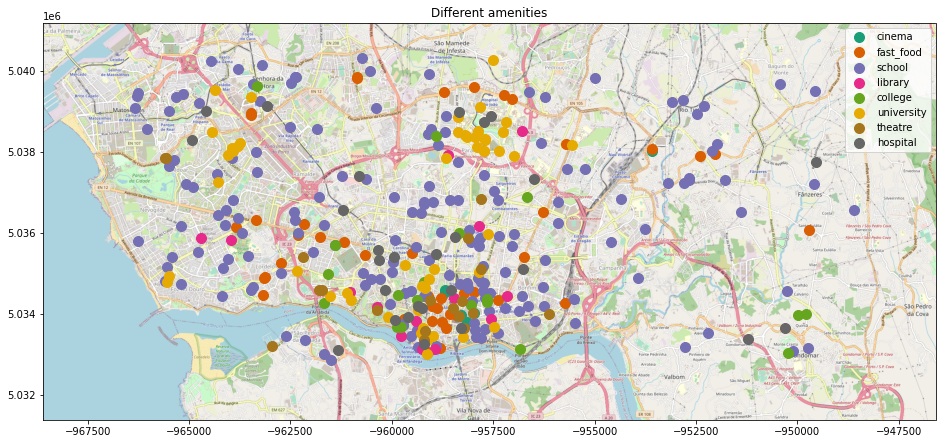

In [22]:
amen_cmap = plt.get_cmap('Dark2', len(amenities_map_dict))

fig, ax = plt.subplots(1, figsize=(16, 16), facecolor = (1,1,1))
ax.imshow(porto_img, extent=porto_ext)
amen_grouped = amenities_mercator_df.groupby('encoded_tags')
for amen_key, amen_group in amen_grouped:
    amen_group.plot(color = amen_cmap((amen_key)), ax = ax, markersize = 100)
plt.legend(list(amenities_map_dict.keys()))
plt.title("Different amenities")
plt.show()

## Amenities dataset

We have to remove primary schools from the dataset, as the demographics that attends these schools is not old enough to ride the scooters. **One could argue that we should remove the basic schools as well.**

In [23]:
prim_schools_df = amenities_df.dropna()[amenities_df["name"].str.contains("Prim").dropna()]

In [24]:
amenities_red_df = amenities_df.drop(prim_schools_df.index).reset_index(drop = True)

## Bus GTFS dataset

**Key conclusions**:
Determined the ride volume per stop and represented it in the map of Porto. This allows us to understand which areas of Porto are currently being well targeted by public transport and which are not.

#### Importing the data

In [25]:
gtfs_bus_folder_path = '/NewFolder/Soft-Mobility/GTFS/GTFS_Bus'

#### Agency

In [26]:
pd.read_csv(gtfs_bus_folder_path + "/agency.txt").T ##Transport agency

,0
agency_id,STCP
agency_name,Sociedade Transportes Colectivos do Porto
agency_url,http://www.stcp.pt
agency_timezone,Europe/Lisbon
agency_lang,pt


#### **Stop times**

In [27]:
bus_stop_times_df = pd.read_csv(gtfs_bus_folder_path + "/stop_times.txt")
## We can use this data to generate a density profile of the ride time, aggregated by probably by stop_id

In [28]:
bus_stop_times_df.head()

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign
0,107_0_D_6,8:47:47,8:47:47,BFAL1,7,NaN
1,107_0_D_6,8:48:27,8:48:27,MCAM3,8,NaN
2,107_0_D_6,8:49:12,8:49:12,ICAM1,9,NaN
3,107_0_D_6,8:50:53,8:50:53,QBNJ2,10,NaN
4,107_0_D_6,8:51:42,8:51:42,TBNJ2,11,NaN


This is a crucial piece of information to know how many buses pass at a certain stop per day.

In [29]:
bus_stop_times_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 831438 entries, 0 to 831437
Data columns (total 6 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   trip_id         831438 non-null  object 
 1   arrival_time    831438 non-null  object 
 2   departure_time  831438 non-null  object 
 3   stop_id         831438 non-null  object 
 4   stop_sequence   831438 non-null  int64  
 5   stop_headsign   0 non-null       float64
dtypes: float64(1), int64(1), object(4)
memory usage: 38.1+ MB


In [30]:
bus_stop_times_df["arrival_time"] =  pd.to_datetime(bus_stop_times_df["arrival_time"].apply(time_shifter))#.dt.time
## Changing the arrival time to the Datetime format

In [31]:
stop_t_unique_dic = {col: bus_stop_times_df[col].unique() for col in bus_stop_times_df.columns}

In [32]:
{ele: len(stop_t_unique_dic[ele]) for ele in stop_t_unique_dic.keys()}

{'trip_id': 22977,
 'arrival_time': 67065,
 'departure_time': 67291,
 'stop_id': 2483,
 'stop_sequence': 63,
 'stop_headsign': 1}

#### **Stop location**

Because the scooter location is restricted to the Porto area, we shall focus on the Porto bus stops.

In [33]:
bus_stops_df = pd.read_csv(gtfs_bus_folder_path + "/stops.txt")

In [34]:
bus_stops_df.head()

,stop_id,stop_code,stop_name,stop_lat,stop_lon,zone_id,stop_url
0,VFRR1,VFRR1,VALE FERREIROS,41.181083,-8.535056,GDM1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...
1,ECC2,ECC2,ENTRE CANCELAS,41.181833,-8.532444,GDM1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...
2,MTP2,MTP2,MONTE PEDRO,41.189528,-8.524389,GDM1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...
3,ASRR4,ASRR4,ALTO DA SERRA,41.193022,-8.518383,GDM1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...
4,VFRR2,VFRR2,VALE FERREIROS,41.181167,-8.535056,GDM1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...


In [35]:
bus_stops_df["zone_id"].unique()

array(['GDM1', 'VLG3', 'PRT3', 'GDM2', 'MTS1', 'MTS2', 'MAI1', 'PRT2',
       'PRT1', 'MAI4', 'VLG1', 'VCD8', 'VNG1', 'MAI3', 'MAI2', 'VNG4',
       'VNG2', 'VLG2', 'VNG5'], dtype=object)

In [36]:
bus_stops_porto_df = bus_stops_df[bus_stops_df["zone_id"].str.contains("PRT")] ##Stops in the Porto area

In [37]:
bus_stop_positions_df_merc = mercator_transform(bus_stops_porto_df)

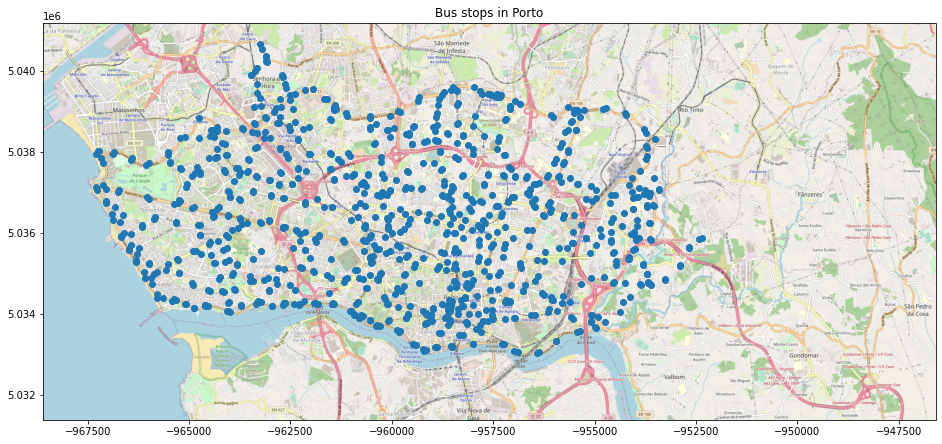

In [38]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
bus_stop_positions_df_merc.plot(ax = ax)
plt.title("Bus stops in Porto")
plt.show()
fig.savefig("/NewFolder/BusStopsPorto.png")

#### **How many buses service a give stop throughout a business day?**

Using stop times and stops 

In [39]:
bus_stop_times_df["trip_id_mod"] = bus_stop_times_df["trip_id"].str.split("_").apply(lambda x: "_".join(x[:-1]))

In [40]:
bus_stop_times_df.head()
print(bus_stop_times_df.shape)

(831438, 7)


**We define the average number of bus/metro rides using the rides ocurring on working days**:

In [41]:
bus_stop_times_ut_df = bus_stop_times_df[bus_stop_times_df["trip_id"].str.contains("U")]
print(bus_stop_times_ut_df.shape)

(198406, 7)


First, we merge the stop_times_df and the relevant part of stops_df.

In [42]:
bus_stop_times_ut_df_aug = bus_stop_times_ut_df.merge(bus_stops_df[["stop_id","zone_id"]], on = "stop_id")
print(bus_stop_times_ut_df_aug.shape)
bus_stop_times_ut_df_aug.head()

(198406, 8)


,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,trip_id_mod,zone_id
0,106_1_U_1,2022-04-23 07:00:00,7:00:00,FRC,1,NaN,106_1_U,VNG4
1,106_0_U_2,2022-04-23 07:28:00,7:28:00,FRC,15,NaN,106_0_U,VNG4
2,106_1_U_3,2022-04-23 07:30:00,7:30:00,FRC,1,NaN,106_1_U,VNG4
3,106_0_U_4,2022-04-23 07:58:00,7:58:00,FRC,15,NaN,106_0_U,VNG4
4,106_1_U_5,2022-04-23 08:00:00,8:00:00,FRC,1,NaN,106_1_U,VNG4


In [43]:
bus_stop_times_porto_df = bus_stop_times_ut_df_aug[bus_stop_times_ut_df_aug["zone_id"].str.contains("PRT")]
print(bus_stop_times_porto_df.shape)

(107131, 8)


In [44]:
bus_stop_times_porto_df.head()

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,trip_id_mod,zone_id
898,107_1_U_1,2022-04-23 06:40:00,6:40:00,AREI2,1,NaN,107_1_U,PRT3
899,107_1_U_3,2022-04-23 07:30:00,7:30:00,AREI2,1,NaN,107_1_U,PRT3
900,107_1_U_5,2022-04-23 08:20:00,8:20:00,AREI2,1,NaN,107_1_U,PRT3
901,107_1_U_7,2022-04-23 09:10:00,9:10:00,AREI2,1,NaN,107_1_U,PRT3
902,107_1_U_9,2022-04-23 10:00:00,10:00:00,AREI2,1,NaN,107_1_U,PRT3


Defines a hourly sampled time series - from 00:00 to 23:00 - of the buses that travel through a given stop, for all the stops:

In [45]:
bus_full_stop_dict = {}
bus_stop_average_dict = {}

porto_stops_list = bus_stop_times_porto_df["stop_id"].unique()

for stop in porto_stops_list:
    var_df = bus_stop_times_porto_df[["trip_id_mod","stop_id","arrival_time"]][bus_stop_times_porto_df["stop_id"] == stop]
    var_df_2 = var_df.pivot_table(index = ["arrival_time","stop_id"], \
                       columns = ["trip_id_mod"], values = ["trip_id_mod"], aggfunc = len, fill_value = 0)\
                       .reset_index(level = "stop_id")
    var_df_3 = extract_stops_resample(var_df_2)
    bus_full_stop_dict[stop] = var_df_3
    bus_stop_average_dict[stop] = var_df_3.drop(columns = ["stop_id"]).sum(axis = 1).mean()

In [46]:
bus_avg_num_rides_stops_df = pd.DataFrame(bus_stop_average_dict, index = ["Average Num Rides p Hour"]).T
bus_avg_num_rides_stops_df.shape

(947, 1)

In [47]:
bus_avg_num_rides_stops_df.describe()

,Average Num Rides p Hour
count,947.000000
mean,4.713613
std,3.509947
min,0.208333
25%,2.041667
50%,4.083333
75%,6.333333
max,27.958333


On average, each stop has about four buses passing by per hour. However, there are much busier locations (like *Campo 24 de Agosto*) which have over 20 buses per hour.

In [48]:
## Let us figure out what are the busiest stops
busiest_bus_stops_df = bus_stops_df.join(bus_avg_num_rides_stops_df, how = "right", on = "stop_code")\
    .sort_values(by = "Average Num Rides p Hour", ascending= False)

In [49]:
n_largest_stops = 10
busiest_bus_stops_df.head(n_largest_stops)

,stop_id,stop_code,stop_name,stop_lat,stop_lon,zone_id,stop_url,Average Num Rides p Hour
347,CMO,CMO,CARMO,41.147228,-8.616959,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,27.958333
2251,PRFL,PRFL,PR.FILIPA DE LENCASTRE,41.148305,-8.612763,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,20.291667
723,PRG1,PRG1,PR. DA GALIZA,41.153444,-8.626333,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,19.916667
732,BS1,BS1,BOAVISTA - B.SUCESSO,41.156403,-8.627930,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,19.916667
199,BCM1,BCM1,BOAVISTA-CASA DA MÚSICA,41.158903,-8.629542,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,19.750000
668,DJOA4,DJOA4,D. JOÃO IV,41.148972,-8.601694,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,19.583333
350,PRDJ,PRDJ,PR. D. JOÃO I,41.147581,-8.609126,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,19.416667
148,HSA5,HSA5,HOSP. ST. ANTÓNIO,41.147766,-8.622450,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,17.833333
1428,IPO4,IPO4,IPO (CIRCUNVAL.),41.183915,-8.604387,PRT3,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,17.291667
1294,GRC1,GRC1,GRACIOSA,41.162921,-8.627502,PRT1,http://www.stcp.pt/pt/viajar/paragens/?t=detal...,17.208333


We now know what are the $n_{busiest}$ stops (in terms of average number of buses per hour). Its map looks something like:

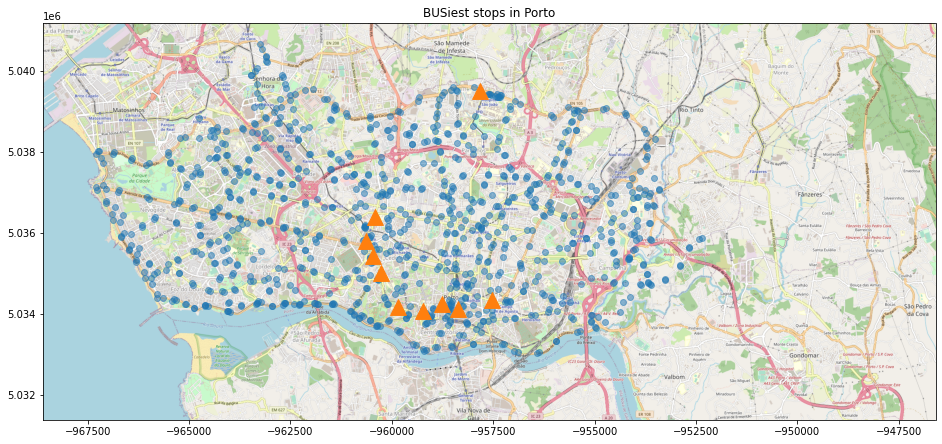

In [50]:
fig, ax = plt.subplots(1, figsize=(16, 16), facecolor = (1,1,1))
ax.imshow(porto_img, extent=porto_ext)
bus_stop_positions_df_merc.plot(ax = ax, alpha = 0.5)
bus_stop_positions_df_merc.loc[busiest_bus_stops_df.index[:n_largest_stops],:].plot(ax = ax,marker = "^", markersize = 250)
plt.title("BUSiest stops in Porto")
plt.show()
fig.savefig("/NewFolder/BusiestStopsPorto.png")

Some examples are:

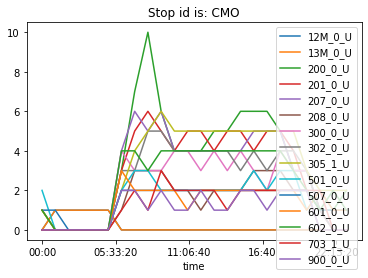

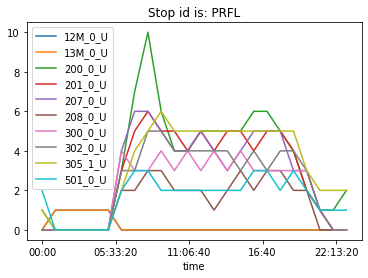

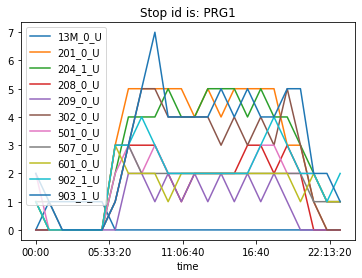

In [51]:
for stop in busiest_bus_stops_df["stop_id"][:3]:
    bus_full_stop_dict[stop].plot()
    plt.title(f"Stop id is: {stop}")
    plt.show()

Using quantiles is quite insightful:

In [52]:
q_list = [0.,0.05,0.5,0.75,0.95,1.]
quantile_list = [busiest_bus_stops_df["Average Num Rides p Hour"].quantile(ele) for ele in q_list]

for quantile in q_list:
    print(f"The average number of rides p hour for the {quantile} percentile is")
    print(busiest_bus_stops_df["Average Num Rides p Hour"].quantile(quantile))

The average number of rides p hour for the 0.0 percentile is
0.20833333333333334
The average number of rides p hour for the 0.05 percentile is
1.0416666666666667
The average number of rides p hour for the 0.5 percentile is
4.083333333333333
The average number of rides p hour for the 0.75 percentile is
6.333333333333333
The average number of rides p hour for the 0.95 percentile is
11.445833333333331
The average number of rides p hour for the 1.0 percentile is
27.958333333333332


In [53]:
quantile_int_labels = [ele for ele in range(len(quantile_list)-1,0,-1)]
busiest_bus_stops_df["Quantile Interval"] = pd.cut(busiest_bus_stops_df["Average Num Rides p Hour"], quantile_list, include_lowest=True, \
    labels = quantile_int_labels)

In [54]:
num_rides_perc_dict = {}

for quant_ind in quantile_int_labels:
    num_rides_perc_dict[quant_ind] = busiest_bus_stops_df[busiest_bus_stops_df["Quantile Interval"] == quant_ind].dropna()

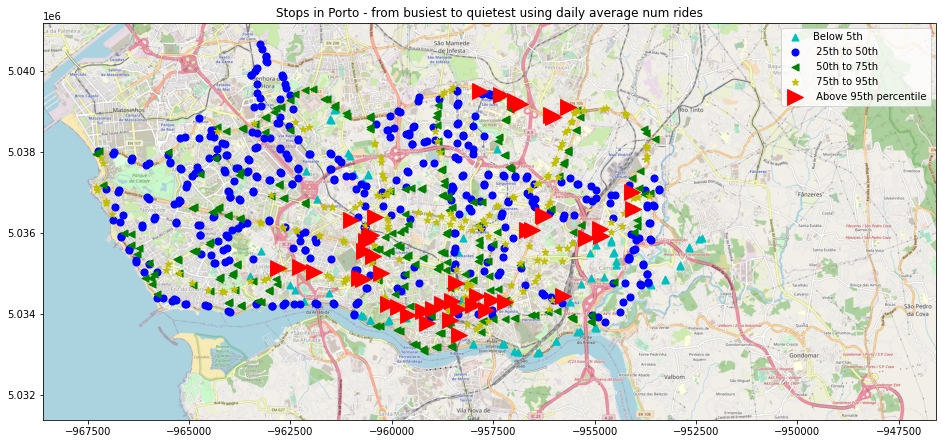

In [55]:
color_list = ["c","b","g","y","r"]
marker_list = ["^","o","<","*",">"]
marker_size_list = [50,50,50,50,250]

fig, ax = plt.subplots(1, figsize=(16, 16), facecolor = (1,1,1))
ax.imshow(porto_img, extent=porto_ext)

for ind, ele in enumerate(quantile_int_labels):

    bus_stop_positions_df_merc.loc[num_rides_perc_dict[ele].index,:].plot(ax = ax,c = color_list[ind], marker = marker_list[ind], \
        markersize = marker_size_list[ind])

plt.title("Stops in Porto - from busiest to quietest using daily average num rides")

txt_string = "Below 5th, 25th to 50th, 50th to 75th, 75th to 95th, Above 95th percentile"

plt.legend(txt_string.split(","))
plt.show()
#fig.savefig("/NewFolder/BusiestStopsPorto.png")

As expected, the center of Porto has the largest average number of rides - partially due to the fact that more lines cross the center of Porto. Key arteries of Porto like *Avenida da Boavista* also have a large number of rides (as represented by the yellow stars).

## Metro GTFS dataset

**Key conclusions**:
Determined the ride volume per stop and represented it in the map of Porto. This allows us to understand which areas of Porto are currently being well targeted by public transport and which are not. *Unfortunately this dataset has the problem that there is ride data missing for the yellow line (line D). See map represented below.*

#### Importing the data

In [56]:
gtfs_metro_folder_path = '/NewFolder/Soft-Mobility/GTFS/GTFS_Metro/google_transit_dez2021'

#### Agency

In [57]:
pd.read_csv(gtfs_metro_folder_path + "/agency.txt").T ##Transport agency

,0
agency_id,NaN
agency_name,Metro do Porto
agency_url,http://www.metrodoporto.pt
agency_timezone,Europe/Lisbon
agency_lang,pt


#### **Stop times**

In [58]:
stop_times_df = pd.read_csv(gtfs_metro_folder_path + "/stop_times.txt")
## We can use this data to generate a density profile of the ride time, aggregated by probably by stop_id

In [59]:
stop_times_df.head()

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled
0,ADF0,6:03:40,6:04:00,1,1,NaN,NaN,NaN,NaN
1,ADF0,6:05:40,6:06:00,2,2,NaN,NaN,NaN,NaN
2,ADF0,6:07:40,6:08:00,3,3,NaN,NaN,NaN,NaN
3,ADF0,6:09:40,6:10:00,4,4,NaN,NaN,NaN,NaN
4,ADF0,6:10:40,6:11:00,5,5,NaN,NaN,NaN,NaN


This is a crucial piece of information to know how many buses pass at a certain stop per day.

In [60]:
stop_times_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27070 entries, 0 to 27069
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   trip_id              27070 non-null  object 
 1   arrival_time         27070 non-null  object 
 2   departure_time       27070 non-null  object 
 3   stop_id              27070 non-null  int64  
 4   stop_sequence        27070 non-null  int64  
 5   stop_headsign        0 non-null      float64
 6   pickup_type          0 non-null      float64
 7   drop_off_type        0 non-null      float64
 8   shape_dist_traveled  0 non-null      float64
dtypes: float64(4), int64(2), object(3)
memory usage: 1.9+ MB


In [61]:
stop_times_df["arrival_time"] =  pd.to_datetime(stop_times_df["arrival_time"].apply(time_shifter))#.dt.time
## Changing the arrival time to the Datetime format

In [62]:
stop_t_unique_dic = {col: stop_times_df[col].unique() for col in stop_times_df.columns}

In [63]:
{ele: len(stop_t_unique_dic[ele]) for ele in stop_t_unique_dic.keys()}

{'trip_id': 1117,
 'arrival_time': 1187,
 'departure_time': 1187,
 'stop_id': 83,
 'stop_sequence': 36,
 'stop_headsign': 1,
 'pickup_type': 1,
 'drop_off_type': 1,
 'shape_dist_traveled': 1}

#### **Stop location**

Because the scooter location is restricted to the Porto area, we shall focus on the Porto bus stops.

In [64]:
stops_df = pd.read_csv(gtfs_metro_folder_path + "/stops.txt")

In [65]:
stops_df.head()

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url
0,1,NaN,Estadio do Dragao,NaN,41.160716,-8.582416,PRT1,NaN
1,2,NaN,Campanha,NaN,41.150537,-8.586245,PRT1,NaN
2,3,NaN,Heroismo,NaN,41.146697,-8.592978,PRT1,NaN
3,4,NaN,24 de Agosto,NaN,41.148796,-8.598349,PRT1,NaN
4,5,NaN,Bolhao,NaN,41.149785,-8.605901,PRT1,NaN


In [66]:
stops_df["zone_id"].unique()

array(['PRT1', 'PRT2', 'MTS1', 'MAI1', 'VCD8', 'VCD3', 'PV_VC', 'MAI2',
       'VNG1', 'PRT3', 'MAI4', 'GDM1'], dtype=object)

In [67]:
stops_porto_df = stops_df[stops_df["zone_id"].str.contains("PRT")] ##Stops in the Porto area

In [68]:
stop_positions_df_merc = mercator_transform(stops_porto_df)

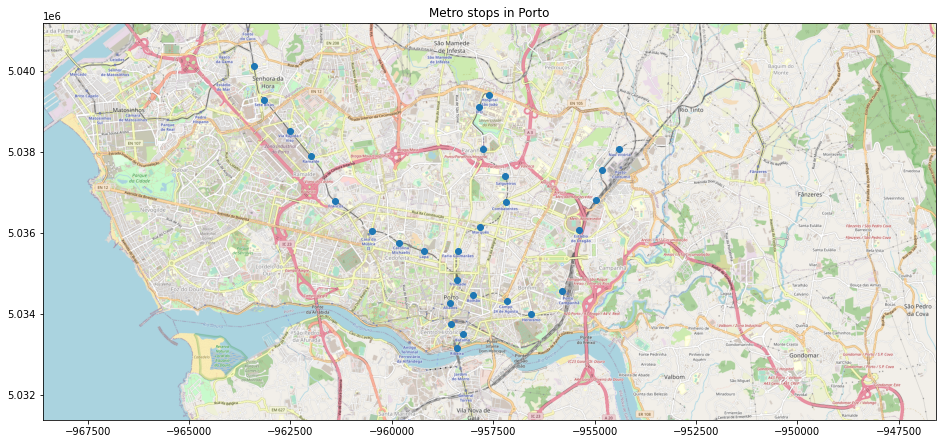

In [69]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
stop_positions_df_merc.plot(ax = ax)
plt.title("Metro stops in Porto")
plt.show()
#fig.savefig("/NewFolder/BusStopsPorto.png")

#### **How many trams service a give stop throughout a business day?**

Using stop times and stops.

In [70]:
stop_times_df.head()
print(stop_times_df.shape)

(27070, 9)


**Subselecting on working day rides**

In [71]:
stop_times_ut_df = stop_times_df[stop_times_df["trip_id"].str.contains("U")]
print(stop_times_ut_df.shape)

(11750, 9)


We want to apply this to all the stops in the Porto area. First, we merge the stop_times_df and the relevant part of stops_df.

In [72]:
stop_times_ut_df_aug = stop_times_ut_df.merge(stops_df[["stop_id","zone_id"]], on = "stop_id")
print(stop_times_ut_df_aug.shape)
stop_times_ut_df_aug.head()

(11750, 10)


,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,zone_id
0,AU0,2022-04-23 06:03:40,6:04:00,1,1,NaN,NaN,NaN,NaN,PRT1
1,AU1,2022-04-23 06:41:40,6:42:00,1,23,NaN,NaN,NaN,NaN,PRT1
2,BU0,2022-04-23 06:00:40,6:01:00,1,1,NaN,NaN,NaN,NaN,PRT1
3,BU2,2022-04-23 06:29:40,6:30:00,1,1,NaN,NaN,NaN,NaN,PRT1
4,BU4,2022-04-23 06:59:40,7:00:00,1,1,NaN,NaN,NaN,NaN,PRT1


In [73]:
stop_times_porto_df = stop_times_ut_df_aug[stop_times_ut_df_aug["zone_id"].str.contains("PRT")]
stop_times_porto_df["stop_id"] = stop_times_porto_df["stop_id"].astype("str")
print(stop_times_porto_df.shape)

(6817, 10)


/tmp/ipykernel_543/2263340528.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stop_times_porto_df["stop_id"] = stop_times_porto_df["stop_id"].astype("str")


In [74]:
stop_times_porto_df.head()

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,zone_id
0,AU0,2022-04-23 06:03:40,6:04:00,1,1,NaN,NaN,NaN,NaN,PRT1
1,AU1,2022-04-23 06:41:40,6:42:00,1,23,NaN,NaN,NaN,NaN,PRT1
2,BU0,2022-04-23 06:00:40,6:01:00,1,1,NaN,NaN,NaN,NaN,PRT1
3,BU2,2022-04-23 06:29:40,6:30:00,1,1,NaN,NaN,NaN,NaN,PRT1
4,BU4,2022-04-23 06:59:40,7:00:00,1,1,NaN,NaN,NaN,NaN,PRT1


In [75]:
full_stop_dict = {}
stop_average_dict = {}

porto_stops_list = stop_times_porto_df["stop_id"].unique()

for stop in porto_stops_list:
    var_df = stop_times_porto_df[["trip_id","stop_id","arrival_time"]][stop_times_porto_df["stop_id"] == stop]
    var_df_2 = var_df.pivot_table(index = ["arrival_time","stop_id"], \
                       columns = ["trip_id"], values = ["trip_id"], aggfunc = len, fill_value = 0)\
                       .reset_index(level = "stop_id")
    var_df_3 = extract_stops_resample(var_df_2).replace(0, np.nan)
    full_stop_dict[int(stop)] = var_df_3
    stop_average_dict[int(stop)] = var_df_3.drop(columns = ["stop_id"]).sum(axis = 1).mean()

In [76]:
avg_num_rides_stops_df = pd.DataFrame(stop_average_dict, index = ["Average Num Rides p Hour"]).T
avg_num_rides_stops_df.shape

(25, 1)

In [77]:
avg_num_rides_stops_df.describe()

,Average Num Rides p Hour
count,25.000000
mean,11.361667
std,9.084231
min,0.083333
25%,0.166667
50%,17.291667
75%,20.458333
max,20.625000


In [78]:
## Let us figure out what are the busiest stops
metroest_stops_df = stops_df.join(avg_num_rides_stops_df, how = "right", on = "stop_id")\
    .sort_values(by = "Average Num Rides p Hour", ascending= False)

In [79]:
n_largest_stops = 10
metroest_stops_df.head(n_largest_stops)

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,Average Num Rides p Hour
5,6,NaN,Trindade,NaN,41.152277,-8.609299,PRT1,NaN,20.625000
12,13,NaN,Sete Bicas,NaN,41.182422,-8.652149,PRT2,NaN,20.458333
13,14,NaN,Senhora da Hora,NaN,41.188101,-8.654466,PRT2,NaN,20.458333
6,7,NaN,Lapa,NaN,41.157107,-8.616723,PRT1,NaN,20.458333
7,8,NaN,Carolina Michaelis,NaN,41.158585,-8.622246,PRT1,NaN,20.458333
8,9,NaN,Casa da Musica,NaN,41.160575,-8.628282,PRT1,NaN,20.458333
9,10,NaN,Francos,NaN,41.165549,-8.636347,PRT1,NaN,20.458333
10,11,NaN,Ramalde,NaN,41.172962,-8.641766,PRT2,NaN,20.458333
11,12,NaN,Via Rapida Viso,NaN,41.177255,-8.646498,PRT2,NaN,20.458333
2,3,NaN,Heroismo,NaN,41.146697,-8.592978,PRT1,NaN,17.291667


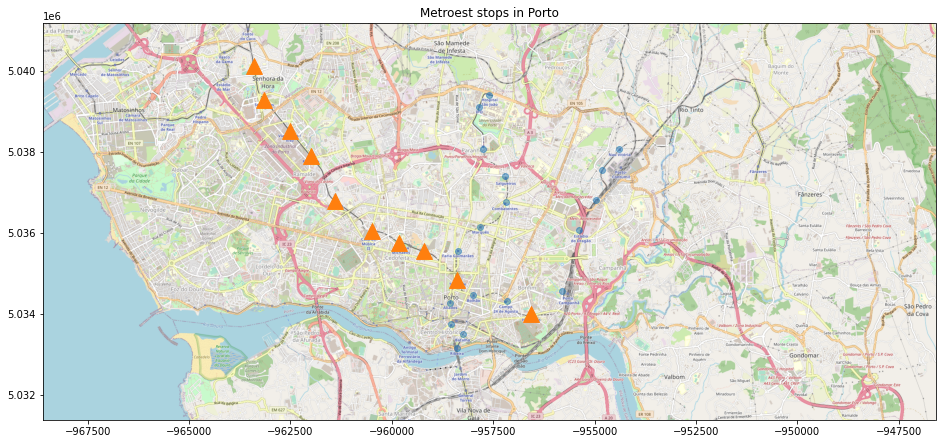

In [80]:
fig, ax = plt.subplots(1, figsize=(16, 16), facecolor = (1,1,1))
ax.imshow(porto_img, extent=porto_ext)
stop_positions_df_merc.plot(ax = ax, alpha = 0.5)
stop_positions_df_merc.loc[metroest_stops_df.index[:n_largest_stops],:].plot(ax = ax,marker = "^", markersize = 250)
plt.title("Metroest stops in Porto")
plt.show()
#fig.savefig("/NewFolder/BusiestStopsPorto.png")

More details on the missing data hinted above:

In [81]:
print(metroest_stops_df.loc[66])

stop_id                            67
stop_code                         NaN
stop_name                      I.P.O.
stop_desc                         NaN
stop_lat                    41.181253
stop_lon                    -8.604521
zone_id                          PRT3
stop_url                          NaN
Average Num Rides p Hour     0.083333
Name: 66, dtype: object


In [82]:
print(full_stop_dict[66])

         stop_id  DU0  DU1  DUPU0  DUPU1
00:00:00      66  NaN  NaN    NaN    NaN
01:00:00      66  NaN  NaN    NaN    NaN
02:00:00      66  NaN  NaN    NaN    NaN
03:00:00      66  NaN  NaN    NaN    NaN
04:00:00      66  NaN  NaN    NaN    NaN
05:00:00      66  NaN  NaN    NaN    NaN
06:00:00      66  1.0  1.0    1.0    NaN
07:00:00      66  NaN  NaN    NaN    1.0
08:00:00      66  NaN  NaN    NaN    NaN
09:00:00      66  NaN  NaN    NaN    NaN
10:00:00      66  NaN  NaN    NaN    NaN
11:00:00      66  NaN  NaN    NaN    NaN
12:00:00      66  NaN  NaN    NaN    NaN
13:00:00      66  NaN  NaN    NaN    NaN
14:00:00      66  NaN  NaN    NaN    NaN
15:00:00      66  NaN  NaN    NaN    NaN
16:00:00      66  NaN  NaN    NaN    NaN
17:00:00      66  NaN  NaN    NaN    NaN
18:00:00      66  NaN  NaN    NaN    NaN
19:00:00      66  NaN  NaN    NaN    NaN
20:00:00      66  NaN  NaN    NaN    NaN
21:00:00      66  NaN  NaN    NaN    NaN
22:00:00      66  NaN  NaN    NaN    NaN
23:00:00      66

IPO does not have only 4 trips per day, data is missing. This can be seen in the map below too.

In [83]:
q_list = [0.,0.25,0.75,1.]
quantile_list = [metroest_stops_df["Average Num Rides p Hour"].quantile(ele) for ele in q_list]

for quantile in q_list:
    print(f"The average number of rides p hour for the {quantile} percentile is")
    print(busiest_bus_stops_df["Average Num Rides p Hour"].quantile(quantile))

The average number of rides p hour for the 0.0 percentile is
0.20833333333333334
The average number of rides p hour for the 0.25 percentile is
2.0416666666666665
The average number of rides p hour for the 0.75 percentile is
6.333333333333333
The average number of rides p hour for the 1.0 percentile is
27.958333333333332


In [84]:
quantile_int_labels = [ele for ele in range(len(quantile_list)-1,0,-1)]
metroest_stops_df["Quantile Interval"] = pd.cut(metroest_stops_df["Average Num Rides p Hour"], quantile_list, include_lowest=True, \
    labels = quantile_int_labels)

In [85]:
metro_num_rides_perc_dict = {}

for quant_ind in quantile_int_labels:
    metro_num_rides_perc_dict[quant_ind] = metroest_stops_df[metroest_stops_df["Quantile Interval"] == quant_ind]

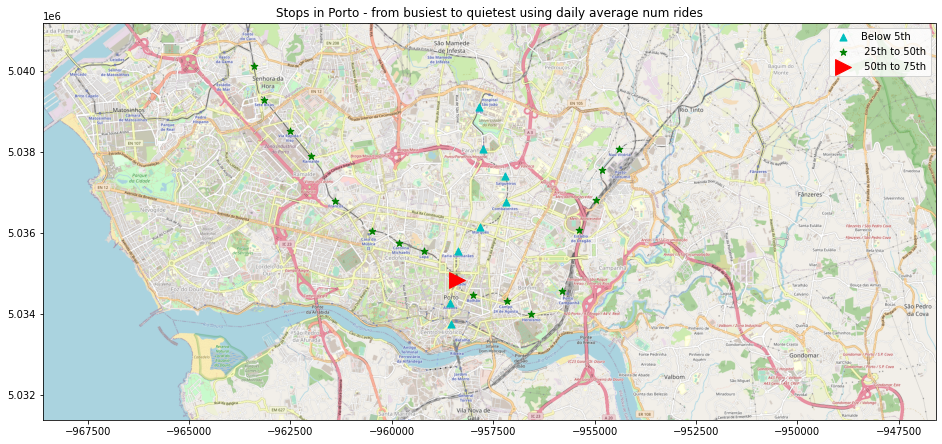

In [86]:
color_list = ["c","g","r"]
marker_list = ["^","*",">"]
marker_size_list = [50,50,250]

fig, ax = plt.subplots(1, figsize=(16, 16), facecolor = (1,1,1))
ax.imshow(porto_img, extent=porto_ext)

for ind, ele in enumerate(quantile_int_labels):

    stop_positions_df_merc.loc[metro_num_rides_perc_dict[ele].index,:].plot(ax = ax,c = color_list[ind], marker = marker_list[ind], \
        markersize = marker_size_list[ind])

plt.title("Stops in Porto - from busiest to quietest using daily average num rides")

txt_string = "Below 5th, 25th to 50th, 50th to 75th, 75th to 95th, Above 95th percentile"

plt.legend(txt_string.split(","))
plt.show()
#fig.savefig("/NewFolder/BusiestStopsPorto.png")

## E-Scooter OD

**Key Conclusions**:
1. Generated an heatmap for scooter rides, which allows us to understand where the users are riding the scooters;
2. Checked what are the reasons why scooters are not available - it looks like riding off juridiction is a common problem;
3. Computed how many scooters have been decomissioned since the program started. This is relevant for policy makers because, for scooters to be an alternative to traditional transportation, they have to be reliable;
4. Computed the distribution of ride lengths to check our hypothesis. There are plenty of long rides, so certainly some people are using them as a replacement of bus/tram, which would refute our hypothesis. However, we are unsure if using a constant average ride velocity for all trip lengths is reasonable - our expectation is, as the rides become longer (in time), users take more breaks such that their average speed goes down and with it, the traveled distance;
5. Checked the start and end times for the rides;

In [87]:
e_scooter_od_path = r"/NewFolder/Soft-Mobility/E-Scooter OD/wdl_od_view.csv"

In [88]:
e_scooter_df = pd.read_csv(e_scooter_od_path)

In [89]:
e_scooter_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 489279 entries, 0 to 489278
Data columns (total 11 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   recorded             489279 non-null  int64  
 1   id                   489279 non-null  int64  
 2   device_id            489279 non-null  object 
 3   timestamp            489279 non-null  int64  
 4   event_types          489279 non-null  object 
 5   vehicle_state        489279 non-null  object 
 6   trip_state           0 non-null       float64
 7   telemetry_timestamp  489279 non-null  int64  
 8   trip_id              179449 non-null  object 
 9   lat                  489279 non-null  float64
 10  lng                  489279 non-null  float64
dtypes: float64(3), int64(4), object(4)
memory usage: 41.1+ MB


In [90]:
for col in ["recorded", "timestamp",  "telemetry_timestamp"]:
  e_scooter_df[col] = pd.to_datetime(e_scooter_df[col],unit='ms')

In [91]:
e_scooter_df = e_scooter_df.sort_values(by = "recorded").reset_index().drop(columns = ["index"], axis = 1).rename(columns = {"lng":"lon"})

In [92]:
scooter_unique_dic = {col: e_scooter_df[col].unique() for col in e_scooter_df.columns}

Check what is the multiplicity of the columns:

In [93]:
{key: len(scooter_unique_dic[key]) for key in scooter_unique_dic.keys()}

{'recorded': 489279,
 'id': 489279,
 'device_id': 3720,
 'timestamp': 451940,
 'event_types': 38,
 'vehicle_state': 7,
 'trip_state': 1,
 'telemetry_timestamp': 437966,
 'trip_id': 79874,
 'lat': 19692,
 'lon': 72030}

Split scooters into working and non-working to have an idea of what percentage (from total) of scooters is working:

In [94]:
working_filter = (e_scooter_df["vehicle_state"] == "available") | (e_scooter_df["vehicle_state"] == "on_trip")
working_e_scooter_df = e_scooter_df[working_filter]

not_working_filter = (e_scooter_df["vehicle_state"] == "removed") | (e_scooter_df["vehicle_state"] == "non_operational") \
| (e_scooter_df["vehicle_state"] == "elsewhere") | (e_scooter_df["vehicle_state"] == "unknown")
not_working_e_scooter_df = e_scooter_df[not_working_filter]

In [95]:
scooter_encoding = {"on_trip": 1, "available": 2}
working_e_scooter_df["route_encoding"] = working_e_scooter_df["vehicle_state"].map(scooter_encoding)

/tmp/ipykernel_543/2400945321.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_e_scooter_df["route_encoding"] = working_e_scooter_df["vehicle_state"].map(scooter_encoding)


In [96]:
print(f"Working fraction: {len(working_e_scooter_df)/len(e_scooter_df)}") 
print(f"Not Working fraction: {len(not_working_e_scooter_df)/len(e_scooter_df)}") ## See more below

Working fraction: 0.47564068762403455
Not Working fraction: 0.5208173659609343


A scooter is either running or available 47% of the time, which seems a bit low. Maybe their batteries are low and they need to be recharged often? This is important to understand because the scooter might have some limitations as a means of transport - apart from carrying only 1/2 **young** people, generally used when the weather is good and roads are dry.

In [97]:
e_s_positions_df_merc = mercator_transform(working_e_scooter_df)

In [98]:
cmap = {1: "b", 2: "r"}

In [99]:
e_s_positions_df_merc["route_encoding"] = working_e_scooter_df["route_encoding"]
## I think that there will be a lot of degenerate rows in working_e_scooter_df when the
## scooters are available, see below

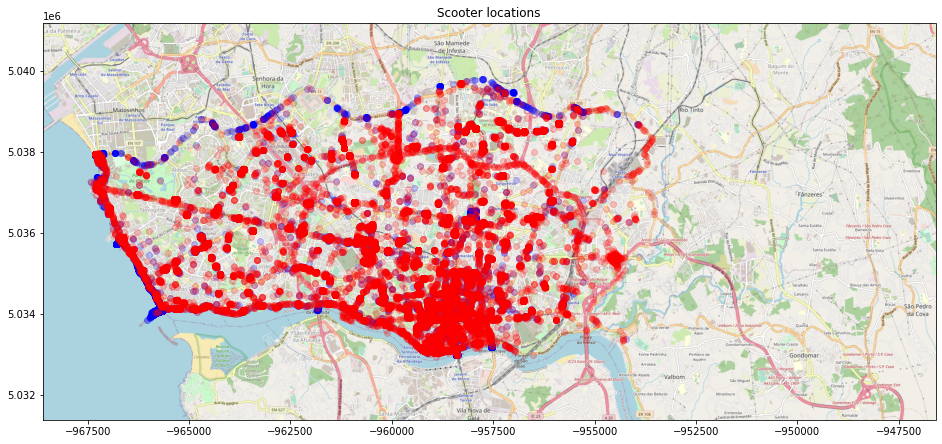

In [100]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
grouped = e_s_positions_df_merc.groupby('route_encoding')
for key, group in grouped:
    group.plot(color = cmap[key], ax = ax, alpha = 0.2)
plt.title("Scooter locations")
plt.show()
fig.savefig("/NewFolder/Scooter_Locations.png")
## This color coding is not clear enough, we probably need to split it into blocks

In [101]:
drop_off_df = e_scooter_df[e_scooter_df["event_types"] == "{provider_drop_off}"]
drop_off_positions_df_merc = mercator_transform(drop_off_df)

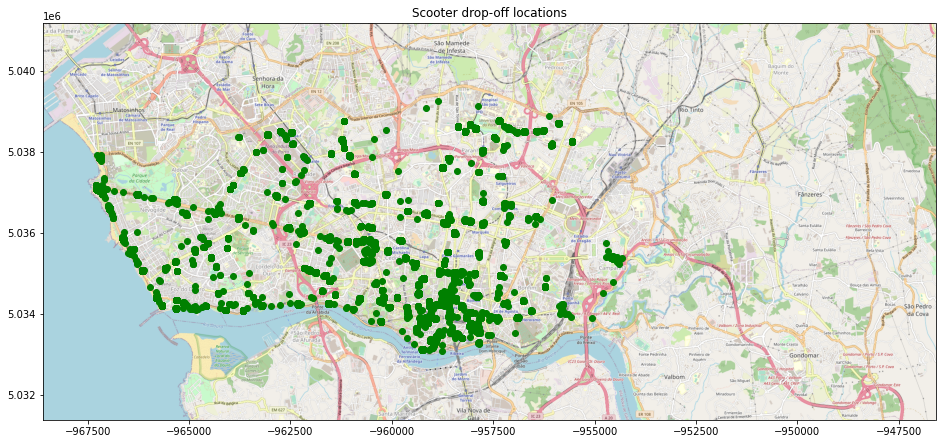

In [102]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
drop_off_positions_df_merc.plot(color = "g", ax = ax)
plt.title("Scooter drop-off locations")
plt.show()
fig.savefig("/NewFolder/Scooter_Dropoff_Locations.png")
## This is very strange, I was not expecting the drop off location to be everywhere...
## Is the size of the points too large, are the GPS sensors turned on during the trips?

In [103]:
## Let us investigate why the scooters do not work

In [104]:
not_working_e_scooter_df["vehicle_state"].value_counts()
## Elsewhere and removed are the most common reasons

elsewhere          96841
removed            90528
unknown            55155
non_operational    12301
Name: vehicle_state, dtype: int64

In [105]:
not_working_e_scooter_df.groupby(["vehicle_state", "event_types"]).agg({"recorded":"count"})

recorded
vehicle_state   event_types                              
elsewhere       {trip_leave_jurisdiction}           16369
                {unspecified,located}               80472
non_operational {battery_low}                        4371
                {comms_restored,battery_low}         1228
                {located,battery_low}                3164
                {missing,located,battery_low}         941
                {provider_drop_off,battery_low}       267
                {trip_cancel,battery_low}              15
                {trip_end,battery_low}               2314
                {unspecified}                           1
removed         {decommissioned}                      142
                {maintenance_pick_up}               89974
                {trip_cancel,decommissioned}            1
                {trip_end,decommissioned}               2
                {unspecified}                         409
unknown         {comms_lost}                        13347
                {missing}                           41715
                {reservation_cancel,comms_lost}        14
                {reservation_cancel,missing}            6
                {trip_cancel,comms_lost}               16
                {trip_cancel,missing}                  16
                {trip_end,comms_lost}                   9
                {trip_end,missing}                     31
                {unspecified}                           1

In [106]:
len(e_scooter_df[e_scooter_df["event_types"] == "{maintenance_pick_up}"])/len(e_scooter_df)

0.1838909906208932

In [107]:
life_of_a_scooter_df = e_scooter_df[e_scooter_df["device_id"] == e_scooter_df["device_id"].unique()[0]]

In [108]:
len(e_scooter_df["device_id"].unique())

3720

In [109]:
decom_scooter_dic = {}
running_scooter_dic = {}

for scooter_id in e_scooter_df["device_id"].unique():
  single_scooter_df = e_scooter_df[e_scooter_df["device_id"] == scooter_id]
  
  if single_scooter_df["event_types"].iloc[-1] == "{decommissioned}":

    decom_scooter_dic[scooter_id] = (single_scooter_df.iloc[-1,0] - single_scooter_df.iloc[0,0]).total_seconds()/3600

  else:
    
    running_scooter_dic[scooter_id] = (single_scooter_df.iloc[-1,0] - single_scooter_df.iloc[0,0]).total_seconds()/3600

In [110]:
print(len(decom_scooter_dic)/len(e_scooter_df["device_id"].unique()))
print(len(running_scooter_dic)/len(e_scooter_df["device_id"].unique()))
##Only two percent of the total amount of scooters have been
## have been decommissioned

0.02768817204301075
0.9723118279569892


In [111]:
decom_scooters_lifetime = np.array(list(decom_scooter_dic.values()))
running_scooters_lifetime = np.array(list(running_scooter_dic.values()))

In [112]:
full_df = pd.DataFrame({"Running": running_scooters_lifetime})
decom_df = pd.DataFrame({"Decomm": decom_scooters_lifetime})
full_df["Decomm"] = decom_df["Decomm"]

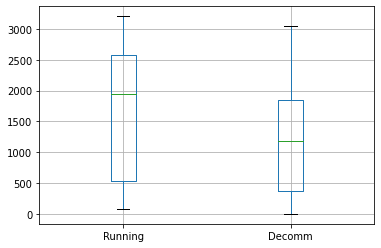

In [113]:
full_df[full_df["Running" ]> 24*3].boxplot()
plt.show()

In [114]:
## This, of course, is the total life time in hours. It would be interesting to see what is the 
## running time

Computing the working time of the scooters and with it, the working distance: 

In [115]:
average_scooter_speed = 20 ## To be adjusted once we know more info

time_duration_scooter_trips = {}
length_duration_scooter_trips = {}
length_mismatch = []

start_times_dict = {}
end_times_dict = {}

for scooter_id in e_scooter_df["device_id"].unique():
    
    single_scooter_df = e_scooter_df[e_scooter_df["device_id"] == scooter_id].reset_index()

    trip_starts = (single_scooter_df["event_types"] == "{trip_start}")
    supposed_end_inds = [ele + 1 for ele in (trip_starts)[trip_starts].index]
    
    trip_ends = (single_scooter_df["event_types"] == "{trip_end}")
    actual_end_inds = [ele for ele in (trip_ends)[trip_ends].index if ele in supposed_end_inds]
    actual_start_inds = [ele - 1 for ele in actual_end_inds]
    
    relevant_inds = (actual_end_inds + actual_start_inds)
    relevant_inds.sort()

    relevant_df = single_scooter_df.loc[relevant_inds]
    relevant_start_df = relevant_df[relevant_df["event_types"] == "{trip_start}"].reset_index()
    relevant_end_df = relevant_df[relevant_df["event_types"] == "{trip_end}"].reset_index()
    
    start_times_dict[scooter_id] = relevant_start_df["timestamp"].dt.hour.values
    end_times_dict[scooter_id] = relevant_end_df["timestamp"].dt.hour.values

    time_duration_scooter_trips[scooter_id] = (relevant_end_df["timestamp"] - relevant_start_df["timestamp"])\
            .dt.seconds.values/(60*60) ## Ride time in hours

    length_duration_scooter_trips[scooter_id] = average_scooter_speed*time_duration_scooter_trips[scooter_id] ##Distance traveled in Km

In [116]:
full_array_start_times = np.concatenate(tuple(values for values in start_times_dict.values()))
full_array_end_times = np.concatenate(tuple(values for values in end_times_dict.values()))

In [117]:
full_array_times = np.concatenate(tuple(values for values in time_duration_scooter_trips.values()))
full_array_lengths = np.concatenate(tuple(values for values in length_duration_scooter_trips.values()))

In [118]:
pd.Series(full_array_times).describe()

count    56154.000000
mean         0.275459
std          0.302160
min          0.001667
25%          0.101111
50%          0.183056
75%          0.336389
max          3.083333
dtype: float64

In [119]:
pd.Series(full_array_lengths).describe()

count    56154.000000
mean         5.509180
std          6.043203
min          0.033333
25%          2.022222
50%          3.661111
75%          6.727778
max         61.666667
dtype: float64

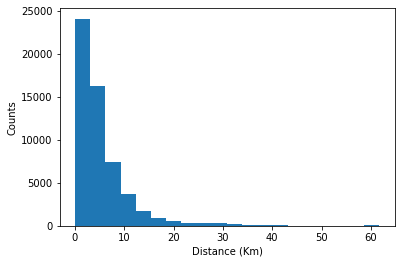

In [120]:
plt.hist(full_array_lengths, bins = 20)
plt.ylabel("Counts")
plt.xlabel("Distance (Km)")
plt.show()

Let us assume that the longest ride takes 20 mins ~ 0.33h, which would still be around 7km:

In [121]:
truncated_array_lengths = np.array([ele for ele in full_array_lengths if ele < 7])

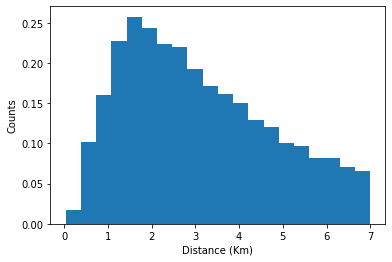

In [122]:
plt.hist(truncated_array_lengths, bins = 20, density = True)
plt.ylabel("Counts")
plt.xlabel("Distance (Km)")
plt.show()

In [123]:
dist_mode = stats.mode(truncated_array_lengths)[0]
dist_median = np.percentile(truncated_array_lengths,0.5)

Check the dependence with start and end times

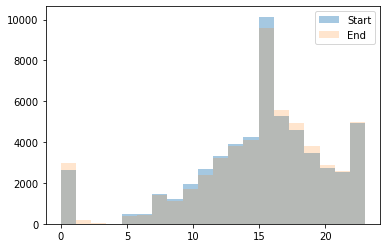

In [124]:
plt.hist(full_array_start_times, bins = 20, alpha = 0.4)
plt.hist(full_array_end_times, bins = 20, alpha = 0.2)
plt.legend(["Start","End"])
plt.show()

In [125]:
e_scooter_df["event_types"].value_counts()

{maintenance_pick_up}                    89974
{unspecified,located}                    80472
{trip_start}                             71909
{trip_end}                               65091
{missing}                                41715
{located}                                40072
{provider_drop_off}                      22576
{trip_enter_jurisdiction}                17072
{trip_leave_jurisdiction}                16369
{comms_lost}                             13347
{missing,located}                         6913
{trip_cancel}                             5967
{battery_low}                             4371
{located,battery_low}                     3164
{trip_end,battery_low}                    2314
{reservation_start}                       1702
{comms_restored}                          1673
{comms_restored,battery_low}              1228
{missing,located,battery_low}              941
{located,trip_start}                       597
{unspecified}                              447
{reservation_

## E-Scooter Parks

**Key conclusions**
Where are the current e-scooter parks located.

In [126]:
escooter_parks_path = r"/NewFolder/Soft-Mobility/E-Scooter Parks"
escooter_file_name = "/e-scooter_parks.json"

In [127]:
with open(escooter_parks_path + escooter_file_name) as json_data:
    data = json.load(json_data)

In [128]:
data.keys()

dict_keys(['displayFieldName', 'fieldAliases', 'geometryType', 'spatialReference', 'fields', 'features'])

In [129]:
fele_features = data['features'][:1]
print(fele_features)
print(type(fele_features))
print(type(fele_features[0]))

[{'attributes': {'objectid_1': 199, 'toponimo': 'Rua de D. Pedro V', 'n_id': 204, 'estado': 'ATIVO', 'sinal_vert': 'NAO', 'sinal_info_vert': 'SIM', 'n_lugares': 10}, 'geometry': {'x': -8.630972406820455, 'y': 41.149252223614546}}]
<class 'list'>
<class 'dict'>


In [130]:
feature_df = pd.DataFrame(data['features'])
feature_df.columns

Index(['attributes', 'geometry'], dtype='object')

In [131]:
feature_attributes_df = feature_df["attributes"].apply(pd.Series) ## Neat solution from Stack Overflow https://stackoverflow.com/questions/38231591/split-explode-a-column-of-dictionaries-into-separate-columns-with-pandas
feature_geometry_df = feature_df["geometry"].apply(pd.Series)

In [132]:
escooter_parks_df = feature_attributes_df.join(feature_geometry_df, how = "left")

In [133]:
escooter_parks_df["estado"].value_counts()

ATIVO    216
Name: estado, dtype: int64

In [134]:
escooter_parks_df = escooter_parks_df.sort_values(by = "objectid_1").set_index("objectid_1").rename(columns = {"x":"lon","y":"lat"})

In [135]:
escooter_parks_df.info()
## We need to be careful because sinal_vert has null values, so we need to do some imputation below

<class 'pandas.core.frame.DataFrame'>
Int64Index: 216 entries, 1 to 1017
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   toponimo         216 non-null    object 
 1   n_id             216 non-null    int64  
 2   estado           216 non-null    object 
 3   sinal_vert       56 non-null     object 
 4   sinal_info_vert  216 non-null    object 
 5   n_lugares        216 non-null    int64  
 6   lon              216 non-null    float64
 7   lat              216 non-null    float64
dtypes: float64(2), int64(2), object(4)
memory usage: 15.2+ KB


In [136]:
escooter_parks_df[["estado", "sinal_vert","sinal_info_vert", "n_lugares"]].fillna("No info").value_counts()
## This is the same as performing a groupby
## We have 48 parks which have no vertical signal, but do have vertical information signal (thanks Obama)
## And have 10 scooters per park

## Only two parks have 20 scooters per park

estado  sinal_vert  sinal_info_vert  n_lugares
ATIVO   No info     SIM              10           158
        NAO         SIM              10            48
        SIM         SIM              10             6
        NAO         SIM              20             2
        No info     SIM              20             2
dtype: int64

In [137]:
park_positions_df_merc = mercator_transform(escooter_parks_df)

Doing a quick clustering - a more educated guess to the number of clusters could be determined by using the silhouette score.

In [138]:
X_parks = escooter_parks_df[["lon","lat"]].values
k_means = KMeans(n_clusters = 4)
y_park_pred = k_means.fit_predict(X_parks)
park_clust = k_means.cluster_centers_

In [139]:
positions_cluster_df_merc = geopd.GeoDataFrame(crs="EPSG:4326", geometry = geopd.points_from_xy(x=park_clust[:,0], y=park_clust[:,1]))\
.to_crs("EPSG:3857")

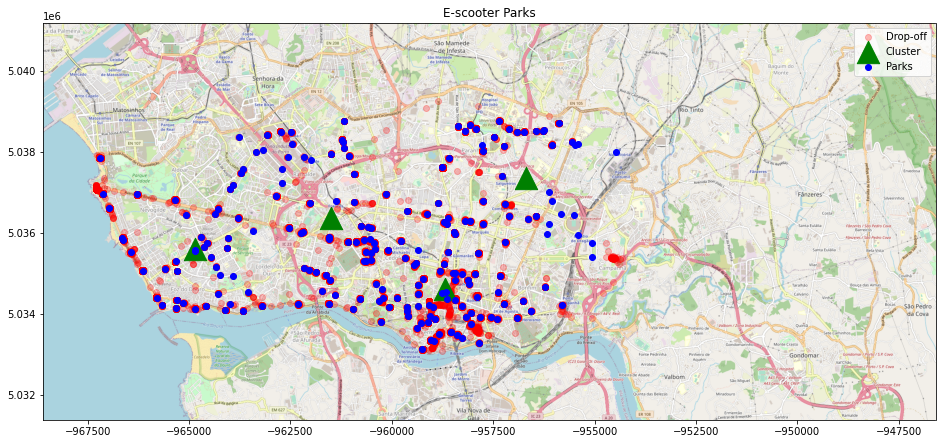

In [140]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
drop_off_positions_df_merc.plot(color = "r", ax = ax, alpha = 0.25)
positions_cluster_df_merc.plot(ax = ax, c = "g", marker = "^", markersize = 500)
park_positions_df_merc.plot(ax = ax, c = "b")
plt.legend(["Drop-off","Cluster","Parks"])
plt.title("E-scooter Parks")
plt.show()
fig.savefig("/NewFolder/EScooterParks.png")
## This color coding is not clear enough, we probably need to split it into blocks

Note that the scooters were often dropped by the company outside of the parks, which is rather strange.

In [141]:
## We can check which points, apart from the parks, do scooters usually get picked up. These likely
## signal positions in which an extra park is needed.

# Modeling

## Model 1

1. Split Porto in a grid of points. For each grid of points, compute the associated population using the *Census* data.
2. Compute an amenity score for each point in this grid. In this particular case, we include bus/metro stops as amenities.
3. Use weighted k-Means - with the number of clusters equal to the number of parks - to design a rough distribution of parks, to be adjusted later as *per* the constraints of the problem (dispersion of parks, geographical considerations, ...)

In [142]:
final_amenities_red_df = amenities_red_df[["lat","lon","name","tags"]]
final_bus_stops_df = busiest_bus_stops_df.reset_index()[["stop_lat","stop_lon", "Average Num Rides p Hour", "stop_name"]]
final_metro_stops_df = metroest_stops_df.reset_index()[["stop_lat","stop_lon", "Average Num Rides p Hour", "stop_name"]]

In [143]:
final_transport_stops_df = pd.concat([final_bus_stops_df, final_metro_stops_df], ignore_index = True)\
    .rename(columns = {"stop_lat":"lat","stop_lon":"lon", "stop_name":"name"})
final_transport_stops_df["tags"] = "stop"
final_transport_stops_df["Average Num Rides Normalized"] = min_max_scaler(final_transport_stops_df["Average Num Rides p Hour"])

In [144]:
final_comb_amenities_df = pd.concat([final_amenities_red_df,final_transport_stops_df.drop(columns = ["Average Num Rides p Hour"])]\
    , ignore_index = True)

In [145]:
pop_data_df = geopd.read_file("/NewFolderPop/BGRI2021_1312.gpkg")

In [146]:
polygons = [x for x in pop_data_df['geometry'].to_crs('epsg:4326')]
s = geopd.GeoSeries(polygons)
porto_area = s.unary_union

xmin, ymin, xmax, ymax= pop_data_df.to_crs('epsg:4326').total_bounds

In [147]:
n_cells = 75
cell_size = (xmax-xmin)/n_cells

crs = "+proj=sinu +lon_0=0 +x_0=0 +y_0=0 +a=6371007.181 +b=6371007.181 +units=m +no_defs"

grid_cells = []
for x0 in np.arange(xmin, xmax+cell_size, cell_size ):
    for y0 in np.arange(ymin, ymax+cell_size, cell_size):
        # bounds
        x1 = x0-cell_size
        y1 = y0+cell_size
        grid_cells.append(sh.geometry.box(x0, y0, x1, y1))
cell = geopd.GeoDataFrame(grid_cells, columns=['geometry'], crs = 'epsg:4326')
points = cell.centroid

/tmp/ipykernel_543/2856847100.py:14: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  points = cell.centroid


In [148]:
points_df = geopd.GeoDataFrame(geometry=geopd.GeoSeries(points))#.to_crs('epsg:4326')
points_df['in_porto'] = points_df['geometry'].within(porto_area)
points_in_porto_df = points_df[points_df.in_porto == True]
points_in_porto_df['lon'] = points_in_porto_df['geometry'].x
points_in_porto_df['lat'] = points_in_porto_df['geometry'].y

/root/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [149]:
points_in_porto_df['population'] = points_in_porto_df.apply(lambda x: get_region(x['geometry'], pop_data_df.to_crs('epsg:4326')), axis = 1)

/root/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


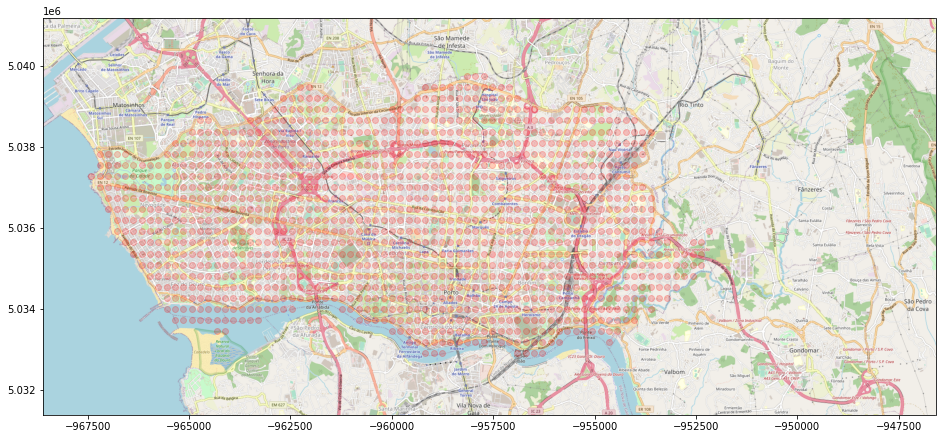

In [150]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
points_in_porto_merc_df = mercator_transform(points_in_porto_df)
points_in_porto_merc_df.plot(ax = ax, alpha=0.2, color = 'red', marker = 'o')
plt.show()

In [151]:
haversine(points_in_porto_df.iloc[0]["lon"], points_in_porto_df.iloc[0]["lat"],\
     points_in_porto_df.iloc[1]["lon"], points_in_porto_df.iloc[1]["lat"])

0.2573534606138501

Initial clustering

In [152]:
kmeans_grid = KMeans(n_clusters = 210)
kmeans_grid.fit(points_in_porto_df[['lat','lon']])

centroids_grid = pd.DataFrame(kmeans_grid.cluster_centers_, columns = ['lat', 'lon'])

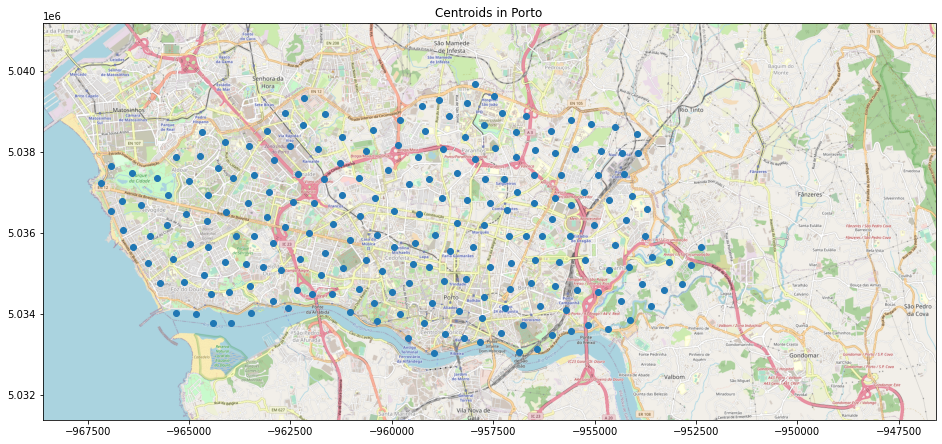

In [153]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
centroids_grid_merc = mercator_transform(centroids_grid)
centroids_grid_merc.plot(ax = ax)
plt.title("Centroids in Porto")
plt.show()
#fig.savefig("./new_folder/Centroids_grid.png")

In [154]:
amenities_relative_weigh_dict = {'bar':1, 'fast_food':2,'theatre':2,'cinema': 2\
    , 'stop' : 3, 'school': 4,'hospital': 5, 'library': 5 \
    , 'college': 5, 'university': 8}

In [155]:
points_in_porto_distances_df = points_in_porto_df.copy(deep = True)
points_in_porto_distances_df['amenities_score'] = points_in_porto_distances_df\
    .apply(lambda x: amenity_score_calc(x['lon'], x['lat'], final_comb_amenities_df, amenities_relative_weigh_dict), axis = 1)

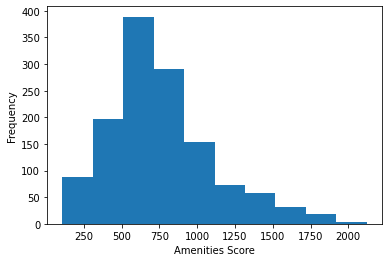

In [156]:
points_in_porto_distances_df['amenities_score'].plot(kind = 'hist')
plt.xlabel("Amenities Score")
plt.show()

In [157]:
q_list = [0.,0.05,0.5,0.75,0.95,1.]
quantile_list = [points_in_porto_distances_df['amenities_score'].quantile(ele) for ele in q_list]
quantile_int_labels = [ele for ele in range(len(quantile_list)-1,0,-1)]
points_in_porto_distances_df["amenity_quantile_interval"] = pd.cut(points_in_porto_distances_df['amenities_score'], \
    quantile_list, include_lowest=True, \
    labels = quantile_int_labels)

In [158]:
points_in_porto_merc_df["amenity_quantile_interval"] = points_in_porto_distances_df["amenity_quantile_interval"]

In [159]:
cmap = plt.get_cmap('Dark2', len(quantile_list))
grouped = points_in_porto_merc_df.groupby("amenity_quantile_interval")

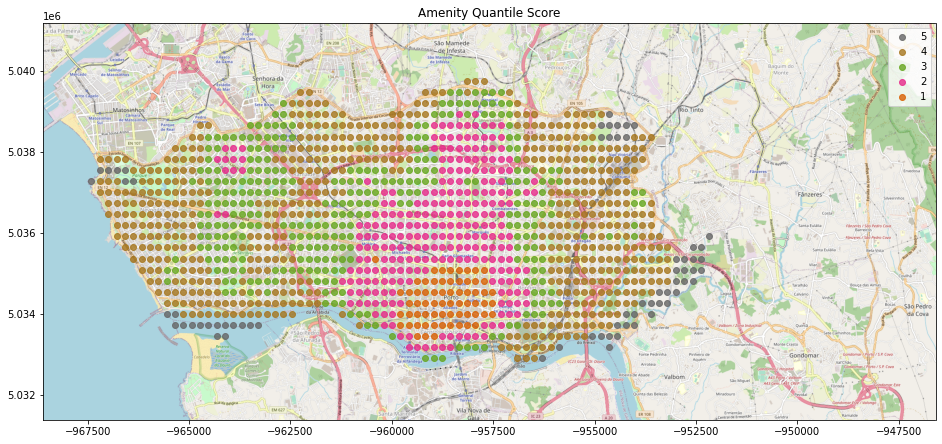

In [160]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)
for key, group in grouped:
    group.plot(color = cmap((key)), ax = ax, alpha = 0.8)
plt.legend(quantile_int_labels)
plt.title("Amenity Quantile Score")
plt.show()

In [161]:
points_in_porto_distances_df["amenity_normalized"] = 100*min_max_scaler(points_in_porto_distances_df["amenities_score"])
points_in_porto_distances_df["population_normalized"] = 100*min_max_scaler(points_in_porto_distances_df["population"])

In [162]:
points_in_porto_distances_df[points_in_porto_distances_df["amenity_quantile_interval"] == 5]["amenity_normalized"] = 0

/root/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [163]:
points_in_porto_distances_df["final weight"] = 1*points_in_porto_distances_df["population_normalized"]  + \
    10*points_in_porto_distances_df["amenity_normalized"]

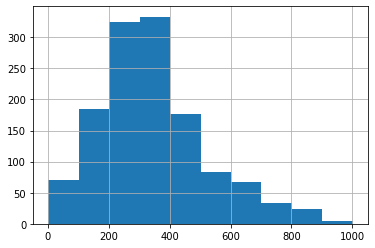

In [164]:
points_in_porto_distances_df["final weight"].hist()
plt.show()

In [165]:
kmeans_grid_weighted = KMeans(n_clusters = 210)
kmeans_grid_weighted.fit(points_in_porto_distances_df[['lat','lon']], points_in_porto_distances_df["final weight"])

centroids_grid_weighted = pd.DataFrame(kmeans_grid_weighted.cluster_centers_, columns = ['lat', 'lon'])
centroids_grid_weighted_merc = mercator_transform(centroids_grid_weighted)

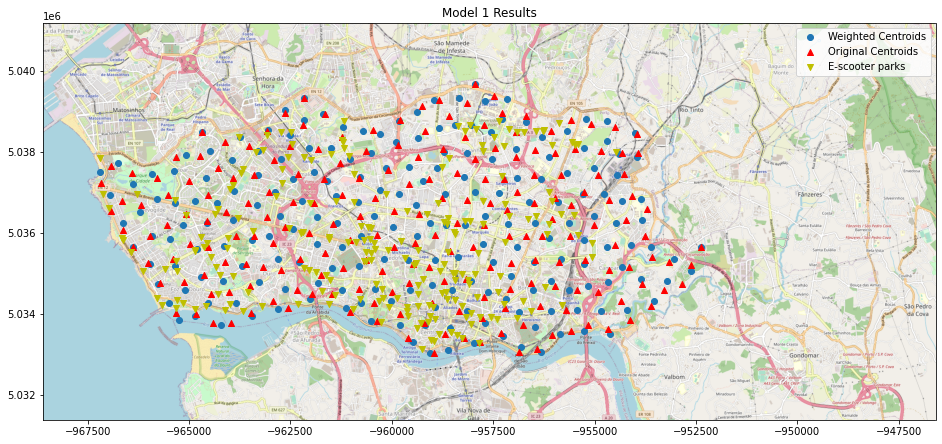

In [166]:
fig, ax = plt.subplots(1, figsize=(16, 16))
ax.imshow(porto_img, extent=porto_ext)

centroids_grid_weighted_merc.plot(ax = ax)
centroids_grid_merc.plot(ax = ax, marker = "^", color = 'red')
park_positions_df_merc.plot(ax = ax, marker = "v", c = "y")

plt.legend(["Weighted Centroids","Original Centroids","E-scooter parks"])
plt.title("Model 1 Results")
plt.show()
#fig.savefig("./new_folder/Centroids_grid_weighted.png")

Comparing the amenity score between the new scooter parks and the old ones:

In [167]:
centroids_grid_weighted['amenities_score'] = centroids_grid_weighted\
    .apply(lambda x: amenity_score_calc(x['lon'], x['lat'], final_comb_amenities_df, amenities_relative_weigh_dict), axis = 1)

In [168]:
centroids_grid_weighted['amenities_score'].describe()

count     210.000000
mean      757.171746
std       345.926641
min       152.742833
25%       546.430557
50%       692.594730
75%       922.374483
max      1909.655783
Name: amenities_score, dtype: float64

In [169]:
escooter_parks_df['amenities_score'] = escooter_parks_df\
    .apply(lambda x: amenity_score_calc(x['lon'], x['lat'], final_comb_amenities_df, amenities_relative_weigh_dict), axis = 1)

In [170]:
escooter_parks_df['amenities_score'].describe()

count     216.000000
mean     1026.947382
std       420.972203
min       320.826131
25%       717.713035
50%       919.434682
75%      1348.253305
max      2012.177295
Name: amenities_score, dtype: float64

The original parks perform better - regarding our amenities score - than the new parks.

## Model 2

1. Determine the level of usage of bus/metro stops.
2. Compute a *modified* amenity score of each bus/metro stops.
3. Apply a weighted clustering algorithm to the stops - with the number of clusters equal to the number of parks - where the weights are a combination of
    * Positive (reward) weights: Average number of rides, amenity score;
    * Negative (penalty) weights: Density of bus stops - if there is a large density of stops, it is possible that the transportation network is well-connected and there is less need for the scooters.

In [171]:
choice_of_input_df = busiest_bus_stops_df

stop_amen_importance_dic = stop_amenity_weighter(choice_of_input_df, amenities_red_df)
stop_importance_dic = {stop: sum(values) for stop, values in stop_amen_importance_dic.items()}

stop_importance_series = pd.Series(stop_importance_dic, name = "Stop Importance")
num_rides_split_1_perc_df = choice_of_input_df.join(stop_importance_series)

Determining stop density - penalty

In [172]:
individual_stop_density_dic = stop_density(num_rides_split_1_perc_df)
total_stop_density_dic = {stop: sum(values) for stop, values in individual_stop_density_dic.items()}

stop_density_series = pd.Series(total_stop_density_dic, name = "Stop Density")
num_rides_split_1_perc_df = num_rides_split_1_perc_df.join(stop_density_series)

In [173]:
num_rides_imp_sorted = num_rides_split_1_perc_df.sort_values(by = "Stop Importance", ascending = False)

Let us normalize the three weights for convenience:

In [174]:
num_rides_norm = min_max_scaler(num_rides_split_1_perc_df["Average Num Rides p Hour"])
stop_importance_norm = min_max_scaler(num_rides_split_1_perc_df["Stop Importance"])
stop_density_norm = min_max_scaler(num_rides_split_1_perc_df["Stop Density"])

In [175]:
num_rides_split_1_perc_df["Average Num Rides p Hour Normalized"] = num_rides_norm
num_rides_split_1_perc_df["Stop Importance Normalized"] = stop_importance_norm
num_rides_split_1_perc_df["Stop Density Normalized"] = stop_density_norm

In [176]:
model_input_df = num_rides_split_1_perc_df[["stop_id","stop_name","stop_lat", "stop_lon","zone_id"] +\
     [col for col in num_rides_split_1_perc_df.columns if "Normalized" in col]]

In [177]:
final_score = min_max_scaler(model_input_df["Average Num Rides p Hour Normalized"] + \
    0.5*model_input_df["Stop Importance Normalized"] - \
    0.5*model_input_df["Stop Density Normalized"])

In [178]:
k_means_base = KMeans(n_clusters = 216)
k_means_base.fit(model_input_df[['stop_lat','stop_lon']], final_score)

base_centroids_weighted = pd.DataFrame(k_means_base.cluster_centers_, columns = ['lat', 'lon'])
base_centroids_weighted_merc = mercator_transform(base_centroids_weighted)

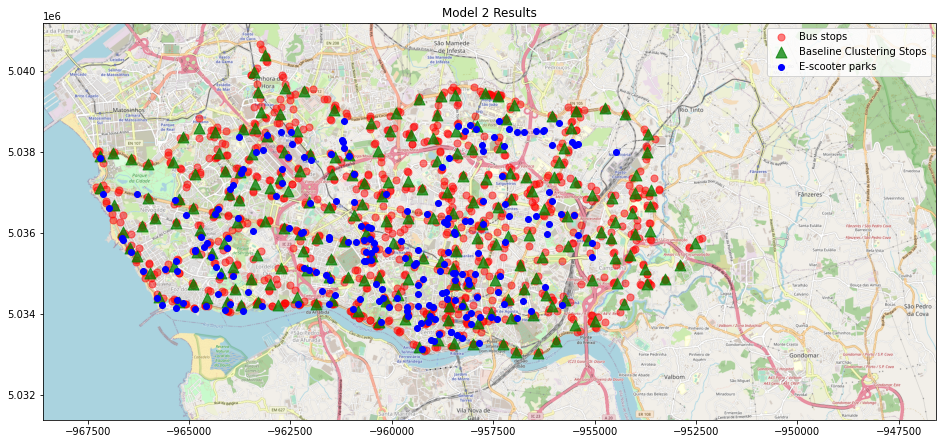

In [179]:
fig, ax = plt.subplots(1, figsize=(16, 16), facecolor = (1,1,1))
ax.imshow(porto_img, extent=porto_ext)

bus_stop_positions_df_merc.plot(ax = ax,c = "r", markersize = 50, alpha = 0.5)
base_centroids_weighted_merc.plot(ax = ax,c = "g", marker = "^", markersize = 120, alpha = 0.75)
park_positions_df_merc.plot(ax = ax, c = "b")

plt.legend(["Bus stops","Baseline Clustering Stops", "E-scooter parks"])
plt.title("Model 2 Results")
plt.show()

In [180]:
base_centroids_weighted['amenities_score'] = base_centroids_weighted\
    .apply(lambda x: amenity_score_calc(x['lon'], x['lat'], final_comb_amenities_df, amenities_relative_weigh_dict), axis = 1)

In [181]:
base_centroids_weighted['amenities_score'].describe()

count     216.000000
mean      845.603824
std       342.731551
min       238.412417
25%       621.045294
50%       772.289168
75%       991.351007
max      2087.415763
Name: amenities_score, dtype: float64

In [182]:
escooter_parks_df['amenities_score'].describe()

count     216.000000
mean     1026.947382
std       420.972203
min       320.826131
25%       717.713035
50%       919.434682
75%      1348.253305
max      2012.177295
Name: amenities_score, dtype: float64

# 🖼️ Visualisations
Copy here the most important visualizations (graphs, charts, maps, images, etc). You can refer to them in the Executive Summary.

Technical note: If not all the visualisations are visible, you can still include them as an image or link - in this case please upload them to your own repository.

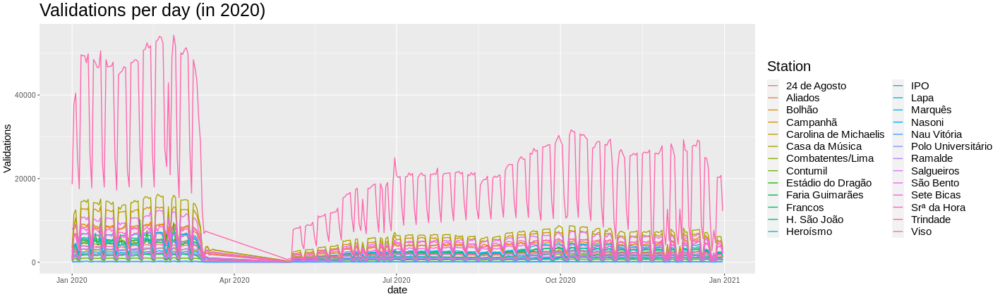

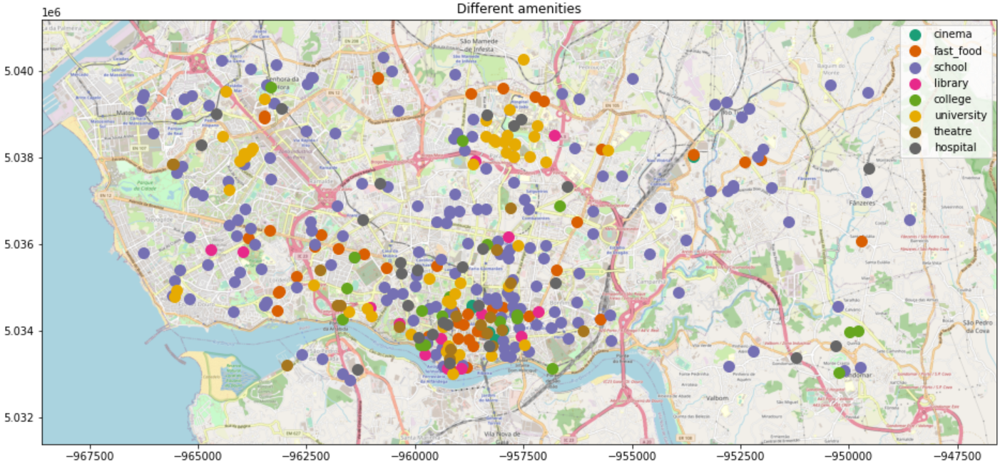

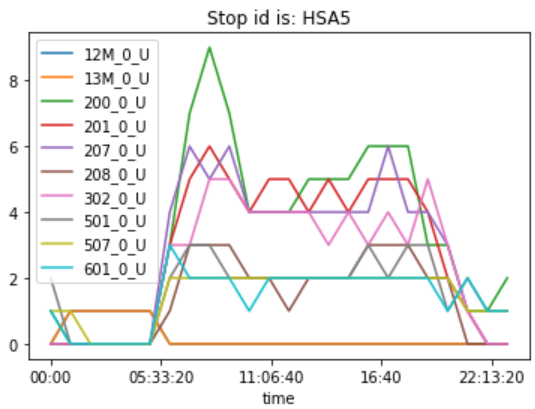

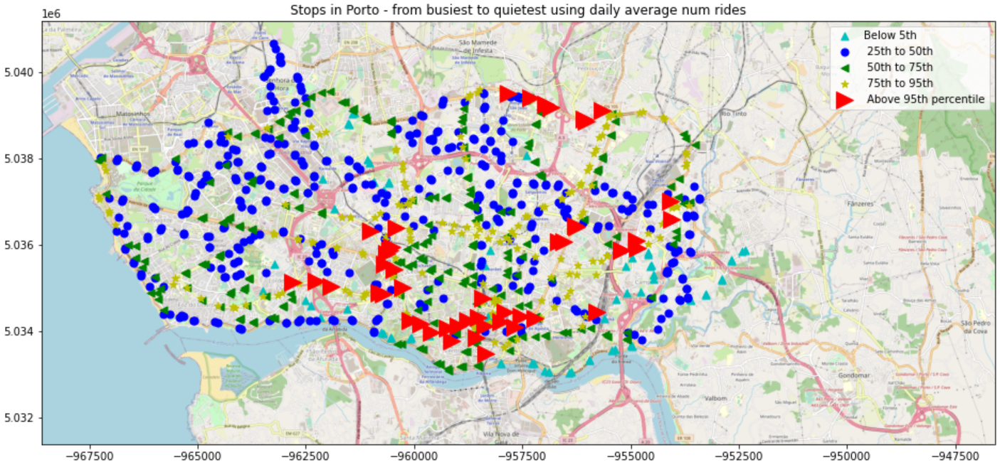

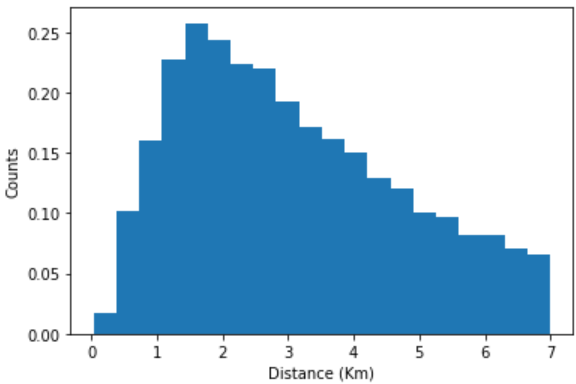

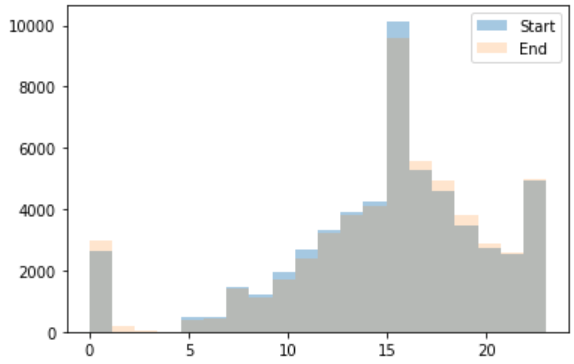

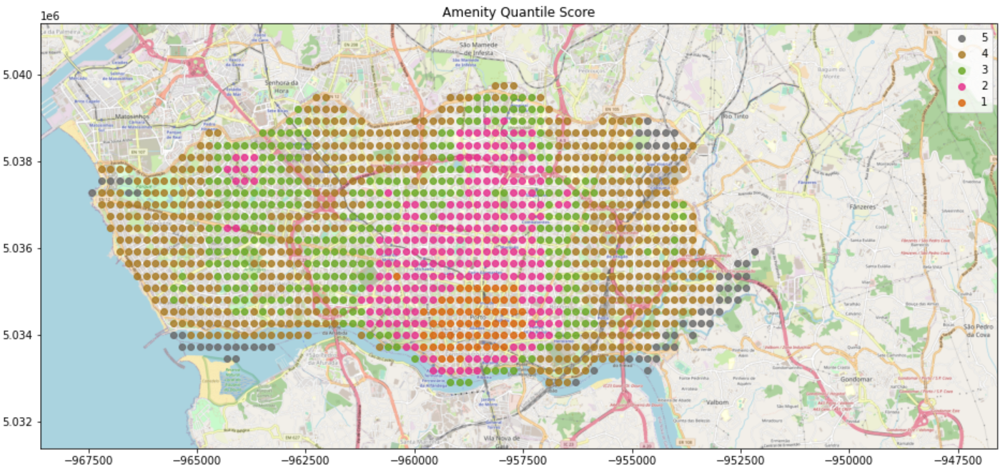

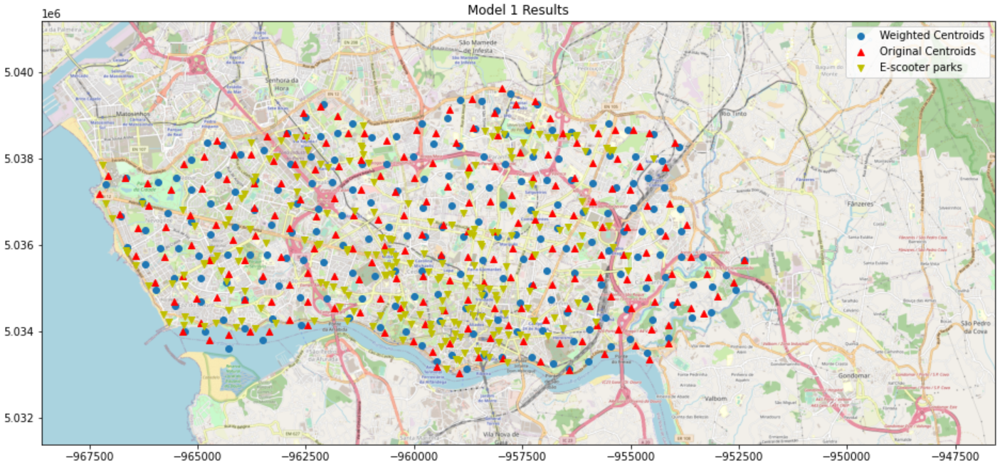

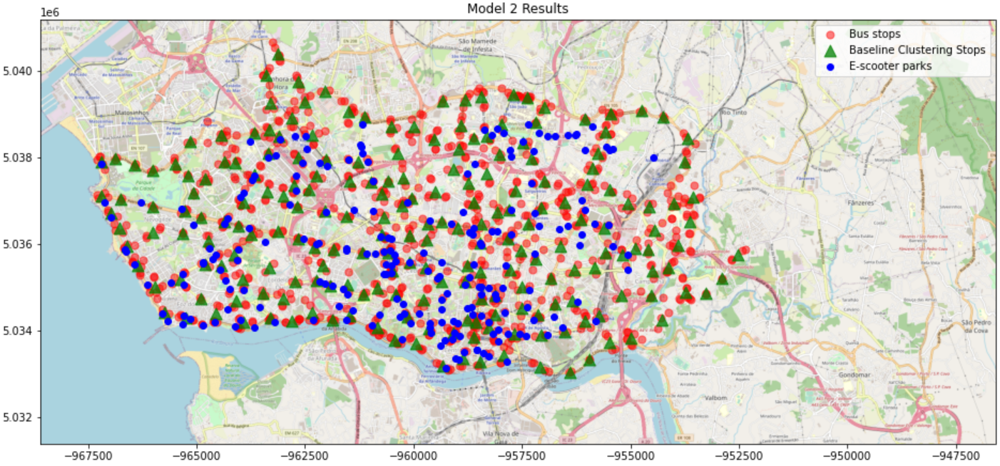

# 👓 References
List all of the external links (even if they are already linked above), such as external datasets, papers, blog posts, code repositories and any other materials.

[*Census* data](http://mapas.ine.pt/download/filesGPG/2021/municipios/BGRI2021_1312.zip) - Portuguese National Institute of Statistics 

Amenity data from [*Open Street Map*](https://www.openstreetmap.org/#map=5/51.330/10.453)

[Burr distribution](https://en.wikipedia.org/wiki/Burr_distribution)

## ⏭️ Appendix
Add here any code, images or text that you still find relevant, but that was too long to include in the main report. This section is optional.


**Other ideas**